<img src='https://i.imgur.com/RDAD11M.png' width = '200' align = 'right'>

## *Section2 Project*

---
<br>

# **반도체 공정 불량품 사전검출 프로세스를 위한 머신러닝 분석**

## 프로젝트 목표 
- 시각적인 분석으로 기본 가설을 수립
- 머신러닝을 통한 분석을 할 수 있는 적합한 모델을 생성
- 머신러닝을 사용하여 가설 검증 및 어떤 변수가 양품/불량품 여부에 크게 기여하는지 파악
- 해석한 결과를 바탕으로 차후 수행할 비지니스 계획에 도움이 되는 인사이트 도출
- 사람이 직관이나 경험적으로 파악하던 문제들을 모델을 통해 수치화하여 수율을 높이고 불량을 낮추기 위한 예방 가이드라인을 세우는데 기여할 것으로 기대

<br>

---

## 목차

- **Part 1. 데이터 선정 및 분석**  
  1-1. 데이터 선정 배경  
  1-2. 머신러닝 문제 정의  
  1-3. EDA 및 전처리 

- **Part 2. ML 모델 학습 및 검증**  
  2-1. Baseline 모델 수립  
  2-2. ML 모델 선정 과정 및 설명  
  2-3. 하이퍼 파라미터 튜닝  
  2-4. 검증 및 일반화 성능 확인  

- **Part 3. 모델 해석 및 결론**    
  3-1. 변수 중요도 확인  
  3-2. 주요 변수 변화로 인한 수율 변동 예측  
  3-3. 결론 및 한계점

# **Part 1. 데이터 선정 및 분석**


## **1-1. 데이터 선정 배경**

- 제조/생산 분야에서 AI를 이용한 수율이나 이상 감지 시스템은 점점 중요해지고 있는 실정이다.
- 특히 반도체는 수율과의 싸움이라 불릴 정도로 수율을 높이고 불량칩을 빠르게 찾아내는것이 무엇보다 중요한 산업이다.  
- 그래서 AI를 이용한 자동화 공정을 통해 생선성을 높이는데 주력하고 있다.
- 사용 데이터 출처 : [**스마트팩토리 반도체 공정 최적화**](https://www.brightics.ai/community/knowledge-sharing/detail/7098)
- 반도체 생산 8대 공정중 일부 공정을 익명화 하여 데이터화 한 것으로 추정된다.
- 순차적인 생산 공정에 대해 비교적 이해하기 쉽고, 반도체 공정에서 제일 중요한 수율 상승을 달성하는데 도움이 될만한 데이터라고 생각하였다. 또한 기존 시스템 하에서의 데이터를 토대로 더 생산성있는 자동화 공정을 수립하는데 머신러닝이 도움이 될 것이라 생각하였기에 선정하였다.

## **1-2. 머신러닝 문제 정의**

- 종류 : **지도학습/분류문제(Fail/Safe)**
- 각 생산품마다 양품, 불량품이 표시된 지도학습/분류문제 유형이다.
- 각 공정의 온도, 습도, 투여되는 화학약품의 유량, 점도, 밀도 편차 및 발생하는 기체들의 편차량들로부터   
  생산품이 정상(label=0)인지 불량(label=1)인지 파악하는 머신러닝 모델을 만들도록 한다.
- 해당 공정은 총 5단계로 이루어져있음
- 공정의 변수(feature)들은 다음과 같음
  - `stage1~stage5` : 제조 공정 1번 ~ 5번(각 변수에 표기)
  - `_temp` : 해당 공정의 온도
  - `_humidity`: 해당 공정의 습도  
  - `_flow_deviation` : 해당 공정에 투여되는 약품의 유량 편차
  - `_density_deviation` : 해당 공정에 투여되는 약품의 밀도 편차
  - `_viscosity_deviation` : 해당 공정에 투여되는 약품의 점성 편차
  - `_co2_deviation` : 해당 공정에서 발생한 이산화탄소 농도 편차
  - `_o2_deviation` : 해당 공정에서 발생한 산소 농도 편차
  - `_n_deviation` : 해당 공정에서 발생한 질소 농도 편차
- 주어진 변수들을 바탕으로 학습시킬 목표는 생산품의 양품, 불량품 여부
  - **`label` : 생산품의 불량품, 양품 여부 (1 : Fail, 0 : Safe) - target**

- 품질에 크게 영향을 주거나, 반대로 상대적으로 별 영향을 주지 않는 변수가 있을 것이고 모델링을 통해 이를 구분해낼 수 있을것이다.
- 모델을 해석하면서 각 변수들의 중요도를 파악할 수 있다면 특정 변수를 통제하는데 더 많은 비용을 투자함으로서  
 기회비용을 최소화하면서 동시에 더 효율적인 공정을 설계할 수 있을것으로 기대할 수 있다. (비지니스 인사이트적 가설)
- 실제 생산에서는 불량품을 불량이라고 판단하는(**Recall**)것이 중요하기 때문에 모델의 정확도와 더불어 이를 중점적으로 판단하고자 한다.



 

## **1-3. EDA 및 전처리**

In [ ]:
'''
# Google Colab을 사용하는 경우 해당 셀을 실행하세요
import sys

if "google.colab" in sys.modules:
    # Install packages in Colab
    !pip install category_encoders==2.*
    !pip install eli5
    !pip install pandas-profiling==2.*
    !pip install xgboost==1.7.2
    
    #pdpdbox 설치 후 런타임을 꼭 다시 실행시켜주세요!!
    !pip install pdpbox
'''

In [1]:
!pip install shap
!pip3 install eli5
!pip3 install imbalanced-learn
!pip install category_encoders
!pip3 install pdpbox
!pip3 install xgboost==1.7.2
!pip install scikit-learn==1.1.3

#pdpdbox 설치 후 런타임을 꼭 다시 실행시켜주세요!!

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.4/572.4 kB 10.3 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 216.2/216.2 kB 5.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for eli5: filename=eli5-0.13.0-py2.py3-none-any.whl size=107747 sha256=419de68fb758fd9355d62b9f7efb7e81542aaf6edc00d37131e81d4ad7ade64c
  Stored in directory: /root/.cache/pip/wheels/7b/26/a5/8460416695a992a2966b41caa5338e5e7fcea98c9d032d055c
Successfully built eli5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.2/81.2 kB 3.5 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/s

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# .read_csv() 활용하여 데이터 불러오기
data = pd.read_csv('/content/drive/MyDrive/dataset/features_train.csv')
label = pd.read_csv('/content/drive/MyDrive/dataset/labels_train.csv')

In [4]:
total_data = pd.concat([data, label], axis=1)
df = total_data.copy()
df

,stage1_temp,stage2_temp,stage3_temp,stage4_temp,stage5_temp,stage1_humidity,stage2_humidity,stage3_humidity,stage4_humidity,stage5_humidity,...,stage4_co2_deviation,stage4_o2_deviation,stage4_n_deviation,stage5_flow_deviation,stage5_density_deviation,stage5_viscosity_deviation,stage5_co2_deviation,stage5_o2_deviation,stage5_n_deviation,label
0,28.57,30.15,30.71,30.91,31.62,69.08,68.98,70.37,73.67,69.41,...,-0.381981,-0.917519,2.905965,NaN,14.642069,NaN,2.249968,NaN,NaN,1
1,31.74,31.29,30.92,29.52,30.70,68.24,75.97,72.06,69.72,76.11,...,NaN,-4.937284,0.089265,-4.937284,12.361204,NaN,3.381750,5.827666,-0.056206,1
2,31.25,29.16,31.45,30.74,30.26,67.98,78.42,70.97,67.71,70.73,...,5.685728,NaN,0.871249,-0.955908,1.587669,1.665659,-0.052572,-0.597566,-2.745544,0
3,29.96,29.22,28.39,31.96,31.12,68.60,67.80,70.09,71.88,76.71,...,5.497906,-2.134062,-1.188985,-2.134062,NaN,NaN,3.230979,-0.032255,0.157905,0
4,30.09,29.58,28.06,30.46,28.84,78.24,67.31,72.63,77.78,74.76,...,7.259878,-0.192612,-1.648626,-0.192612,9.741397,NaN,-0.516248,2.129390,0.020616,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16993,29.68,29.91,30.18,30.78,28.06,77.29,75.94,75.59,73.05,73.09,...,-6.240376,-1.627189,-0.384339,-1.627189,NaN,NaN,2.343462,-0.342200,1.252295,0
16994,30.24,28.95,28.87,28.94,29.23,76.02,71.39,68.73,70.77,69.52,...,-1.139003,2.228396,NaN,2.228396,5.861357,NaN,NaN,NaN,1.744824,1
16995,28.44,28.81,31.56,30.57,28.79,72.11,70.08,73.60,73.15,68.72,...,3.729189,NaN,0.124091,-0.859033,-0.722216,4.351513,0.000299,NaN,NaN,0
16996,28.17,28.47,28.79,28.99,29.71,75.93,77.20,67.56,76.45,76.70,...,-1.567624,-2.373612,-0.820434,-2.373612,-5.930715,NaN,-2.000998,4.125043,-0.552398,0


총 데이터 숫자는 16998개이며 특성의 개수는 40개이다.(target 제외)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16998 entries, 0 to 16997
Data columns (total 41 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   stage1_temp                 16998 non-null  float64
 1   stage2_temp                 16998 non-null  float64
 2   stage3_temp                 16998 non-null  float64
 3   stage4_temp                 16998 non-null  float64
 4   stage5_temp                 16998 non-null  float64
 5   stage1_humidity             16998 non-null  float64
 6   stage2_humidity             16998 non-null  float64
 7   stage3_humidity             16998 non-null  float64
 8   stage4_humidity             16998 non-null  float64
 9   stage5_humidity             16998 non-null  float64
 10  stage1_flow_deviation       11188 non-null  float64
 11  stage1_density_deviation    16073 non-null  float64
 12  stage1_viscosity_deviation  15591 non-null  float64
 13  stage1_co2_deviation        106

온도, 습도에는 결측치가 존재하지 않는다. 나머지 공정의 결측치 비율을 barplot으로 그려보았다.



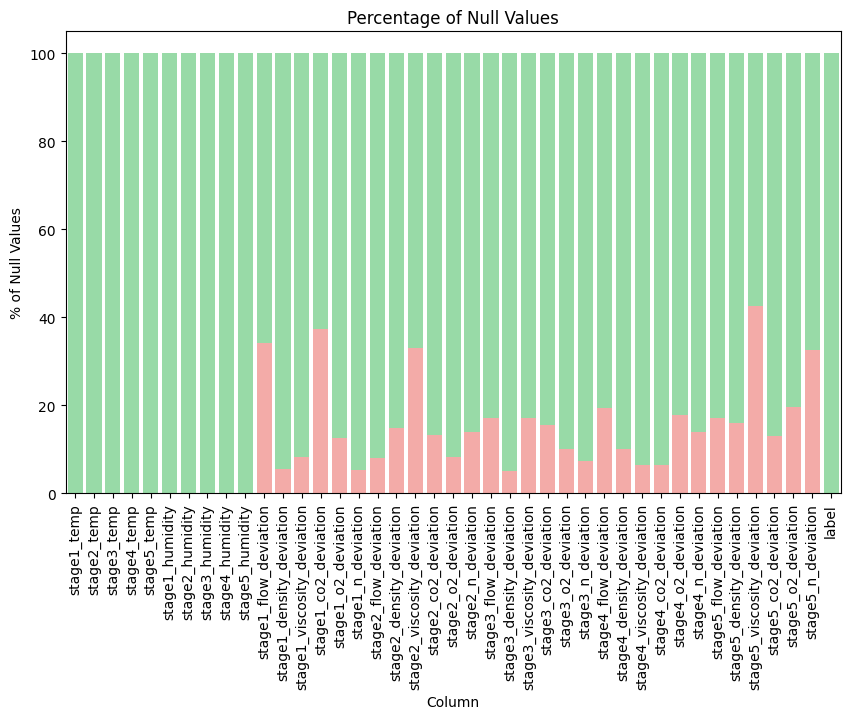

In [6]:
# 각 컬럼의 결측치 비율을 barplot으로 표시

null_perc = df.isnull().mean() * 100
not_null_perc = 100 - null_perc

# sns.set_style("whitegrid")
pastel_colors = sns.color_palette("pastel")
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(x=null_perc.index, y=null_perc.values, color=pastel_colors[3], ax=ax)
sns.barplot(x=null_perc.index, y=not_null_perc.values, color=pastel_colors[2], bottom=null_perc.values, ax=ax)
ax.set_xlabel('Column')
ax.set_ylabel('% of Null Values')
ax.set_title('Percentage of Null Values')
plt.xticks(rotation=90)
plt.show()

In [ ]:
df.describe(include='all').T

,count,mean,std,min,25%,50%,75%,max
stage1_temp,16998.0,30.001594,1.147790,28.000000,29.010000,30.000000,31.000000,32.000000
stage2_temp,16998.0,29.990075,1.151904,28.000000,28.980000,30.000000,30.990000,32.000000
stage3_temp,16998.0,29.997045,1.158444,28.000000,28.990000,30.000000,31.000000,32.000000
stage4_temp,16998.0,30.001217,1.151763,28.000000,29.020000,29.990000,30.990000,32.000000
stage5_temp,16998.0,30.002879,1.160540,28.000000,29.000000,30.010000,31.020000,32.000000
stage1_humidity,16998.0,72.979076,3.468240,67.000000,69.950000,72.990000,75.960000,79.000000
stage2_humidity,16998.0,72.992427,3.466325,67.000000,69.990000,72.970000,75.990000,79.000000
stage3_humidity,16998.0,72.963232,3.471202,67.000000,69.960000,72.900000,75.950000,79.000000
stage4_humidity,16998.0,73.043451,3.459762,67.000000,70.100000,73.040000,76.030000,79.000000
stage5_humidity,16998.0,72.978755,3.468162,67.000000,70.000000,72.950000,75.987500,79.000000


수치형 데이터들을 뜯어본 결과 최대값 최소값이 일치하고 평균도 큰 차이가 없는 등, 온도와 습도는 각 공정간 차이가 없어보인다.  
만약 그렇다고 하면 온도와 습도를 평균치로 합쳐 특성의 숫자를 크게 줄일 수 있을것이다.  
좀 더 명확한 증명을 위해 ANOVA 분산분석을 수행하였다.

ANOVA : temp, humidity

In [5]:
from scipy.stats import f_oneway

# Convert the temp columns to arrays
temp1 = data['stage1_temp'].values
temp2 = data['stage2_temp'].values
temp3 = data['stage3_temp'].values
temp4 = data['stage4_temp'].values
temp5 = data['stage5_temp'].values

# Perform the ANOVA test
stat, p_value = f_oneway(temp1, temp2, temp3, temp4, temp5)

print(p_value)

0.8453080161333163


In [6]:
# Convert the temp columns to arrays
humidity1 = data['stage1_humidity'].values
humidity2 = data['stage2_humidity'].values
humidity3 = data['stage3_humidity'].values
humidity4 = data['stage4_humidity'].values
humidity5 = data['stage5_humidity'].values

# Perform the ANOVA test
stat, p_value = f_oneway(humidity1, humidity2, humidity3, humidity4, humidity5)

print(p_value)

0.2489813001246337


둘 다 p-value > 0.05 를 훨씬 넘겼다. 따라서 각 공정간 temp, humidity는 유의미한 차이가 있다고 할 수 없으므로   
혹시 모를 다중공선성 문제 해소를 위해 각 데이터별로 평균을 내어 하나로 통합한다.

In [7]:
df['temp'] = df[['stage1_temp', 'stage2_temp', 'stage3_temp', 'stage4_temp', 'stage5_temp']].mean(axis=1)
df['humidity'] = df[['stage1_humidity', 'stage2_humidity', 'stage3_humidity', 'stage4_humidity', 'stage5_humidity']].mean(axis=1)

# 필요없는 컬럼 제거
df.drop(['stage1_temp', 'stage2_temp', 'stage3_temp', 'stage4_temp', 'stage5_temp'], axis=1, inplace=True)
df.drop(['stage1_humidity', 'stage2_humidity', 'stage3_humidity', 'stage4_humidity', 'stage5_humidity'], axis=1, inplace=True)

# 컬럼 재배치
col1 = df.columns[-2:].to_list()
col2 = df.columns[:-2].to_list()
new_col = col1 + col2
df = df[new_col]

In [8]:
df

,temp,humidity,stage1_flow_deviation,stage1_density_deviation,stage1_viscosity_deviation,stage1_co2_deviation,stage1_o2_deviation,stage1_n_deviation,stage2_flow_deviation,stage2_density_deviation,...,stage4_co2_deviation,stage4_o2_deviation,stage4_n_deviation,stage5_flow_deviation,stage5_density_deviation,stage5_viscosity_deviation,stage5_co2_deviation,stage5_o2_deviation,stage5_n_deviation,label
0,30.392,70.302,NaN,3.217163,5.716122,2.885678,-1.830675,-0.229145,3.897850,-5.759907,...,-0.381981,-0.917519,2.905965,NaN,14.642069,NaN,2.249968,NaN,NaN,1
1,30.834,72.420,2.168080,2.899058,0.838872,NaN,0.179070,-0.678211,-0.336600,NaN,...,NaN,-4.937284,0.089265,-4.937284,12.361204,NaN,3.381750,5.827666,-0.056206,1
2,30.572,71.162,NaN,2.700569,1.686915,1.783114,1.001300,-0.649136,5.108084,-9.791527,...,5.685728,NaN,0.871249,-0.955908,1.587669,1.665659,-0.052572,-0.597566,-2.745544,0
3,30.130,71.016,-4.743517,0.326173,1.359592,3.879756,0.743327,-0.809781,-2.535448,10.661374,...,5.497906,-2.134062,-1.188985,-2.134062,NaN,NaN,3.230979,-0.032255,0.157905,0
4,29.406,74.144,-2.484233,4.694635,0.452394,-0.741553,-0.027711,-0.729316,-10.559326,NaN,...,7.259878,-0.192612,-1.648626,-0.192612,9.741397,NaN,-0.516248,2.129390,0.020616,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16993,29.722,74.992,-2.795190,-0.362146,NaN,3.740531,-0.854161,0.553653,2.143183,14.063821,...,-6.240376,-1.627189,-0.384339,-1.627189,NaN,NaN,2.343462,-0.342200,1.252295,0
16994,29.246,71.286,NaN,0.814505,0.871520,1.700858,0.114318,-0.656151,-1.132321,-4.847292,...,-1.139003,2.228396,NaN,2.228396,5.861357,NaN,NaN,NaN,1.744824,1
16995,29.634,71.532,NaN,3.188329,-0.615150,NaN,1.976959,NaN,-3.958995,-2.603714,...,3.729189,NaN,0.124091,-0.859033,-0.722216,4.351513,0.000299,NaN,NaN,0
16996,28.826,74.768,0.961052,1.092366,-2.545665,NaN,NaN,-0.637596,-5.690331,1.544018,...,-1.567624,-2.373612,-0.820434,-2.373612,-5.930715,NaN,-2.000998,4.125043,-0.552398,0


train_test_split를 사용해 데이터셋을 train, validation, test의 3-hold out으로 분리하였다.   
각 데이터셋은 target값의 비율을 맞춰주었다.

In [9]:
from sklearn.model_selection import train_test_split

target = 'label'
feature = df.columns.drop(target)

X = df[feature]
y = df[target]

# train, test set을 8:2로 분리
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# train, validation set을 다시 8:2로 분리
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42, stratify=y_train)

In [10]:
# train set eda용 데이터셋

train_eda = pd.concat([X_train, y_train], axis=1)

train 데이터셋에 대해 각 특성들이 다른 특성들과 어떤 상관관계가 있는지 boxplot과 pairplot을 통해 대략적으로 알아보도록 하겠다.

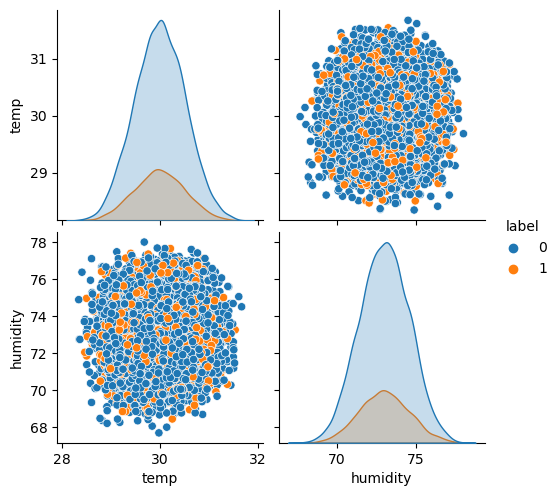

In [ ]:
sns.pairplot(train_eda[['temp','humidity','label']], hue='label')

온도와 습도간에는 유의미한 상관관계를 찾기 어렵다.  
다음은 각 특성 변수별로 stage간의 상관관계를 파악해보도록 한다.

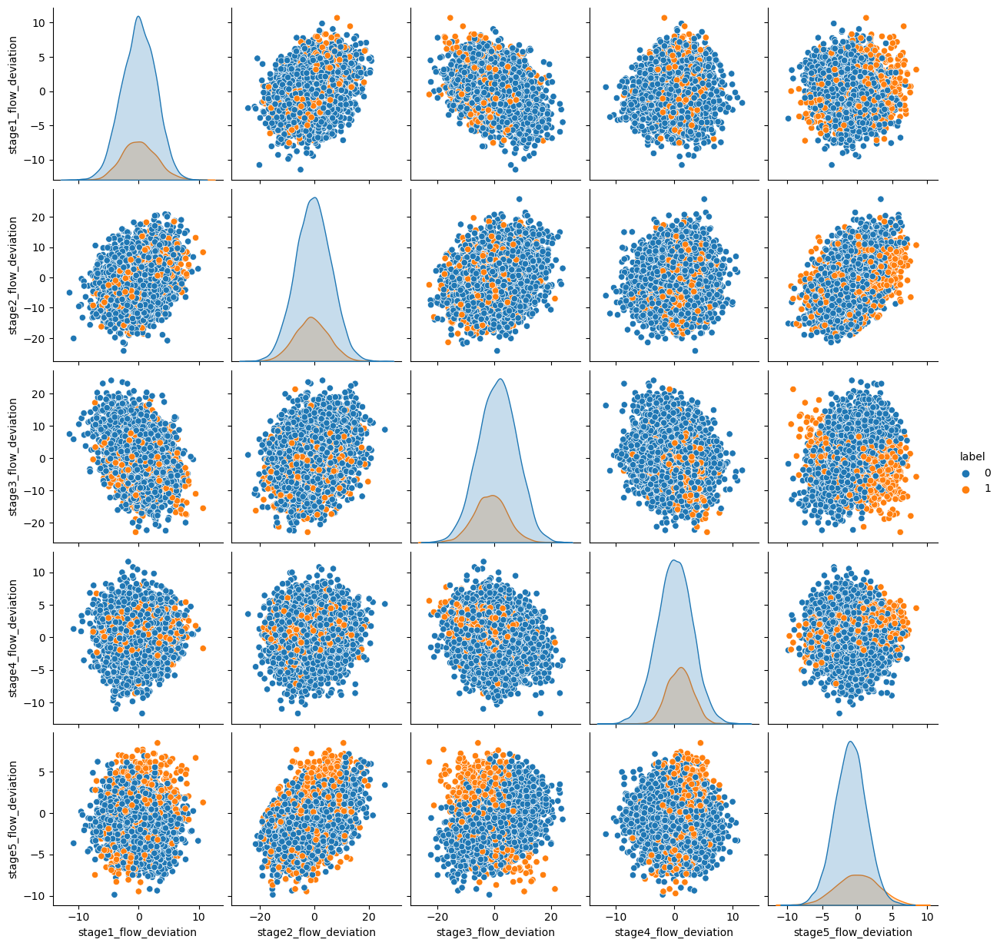

In [ ]:
sns.pairplot(train_eda[['stage1_flow_deviation', 'stage2_flow_deviation','stage3_flow_deviation','stage4_flow_deviation','stage5_flow_deviation', 'label']], hue='label')

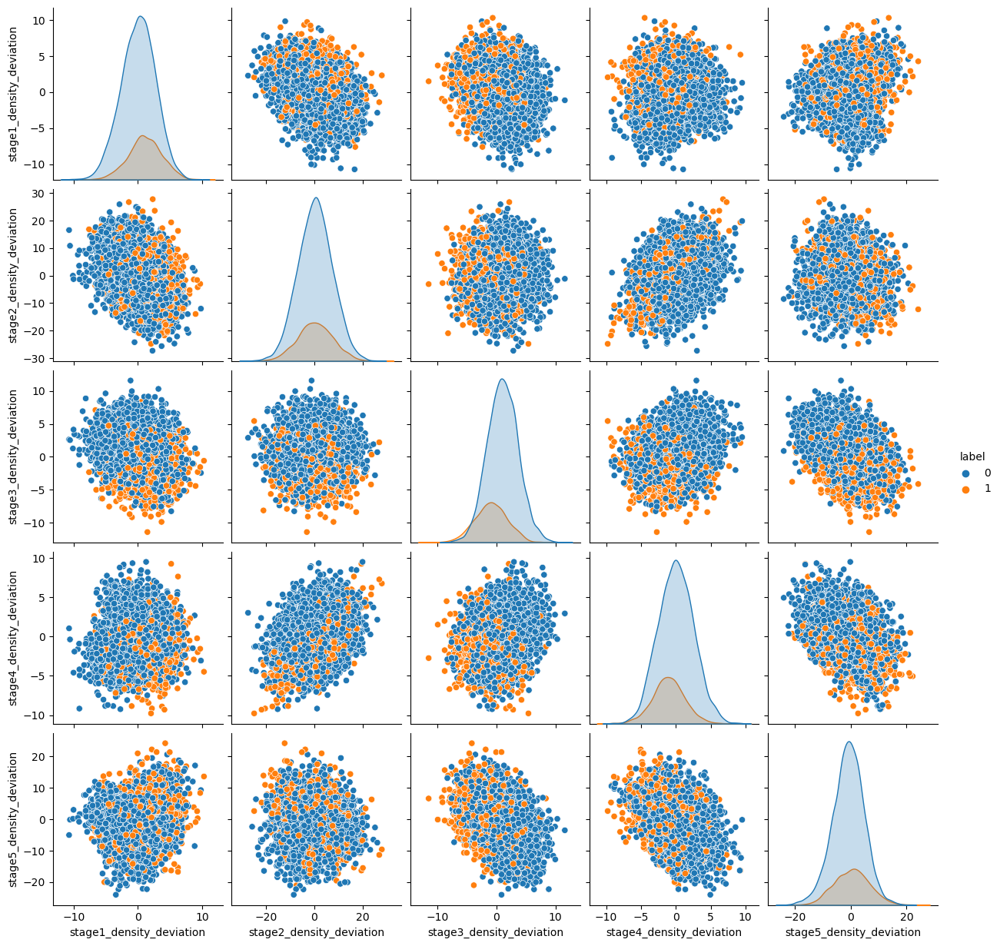

In [ ]:
sns.pairplot(train_eda[['stage1_density_deviation', 'stage2_density_deviation','stage3_density_deviation','stage4_density_deviation','stage5_density_deviation', 'label']], hue='label')

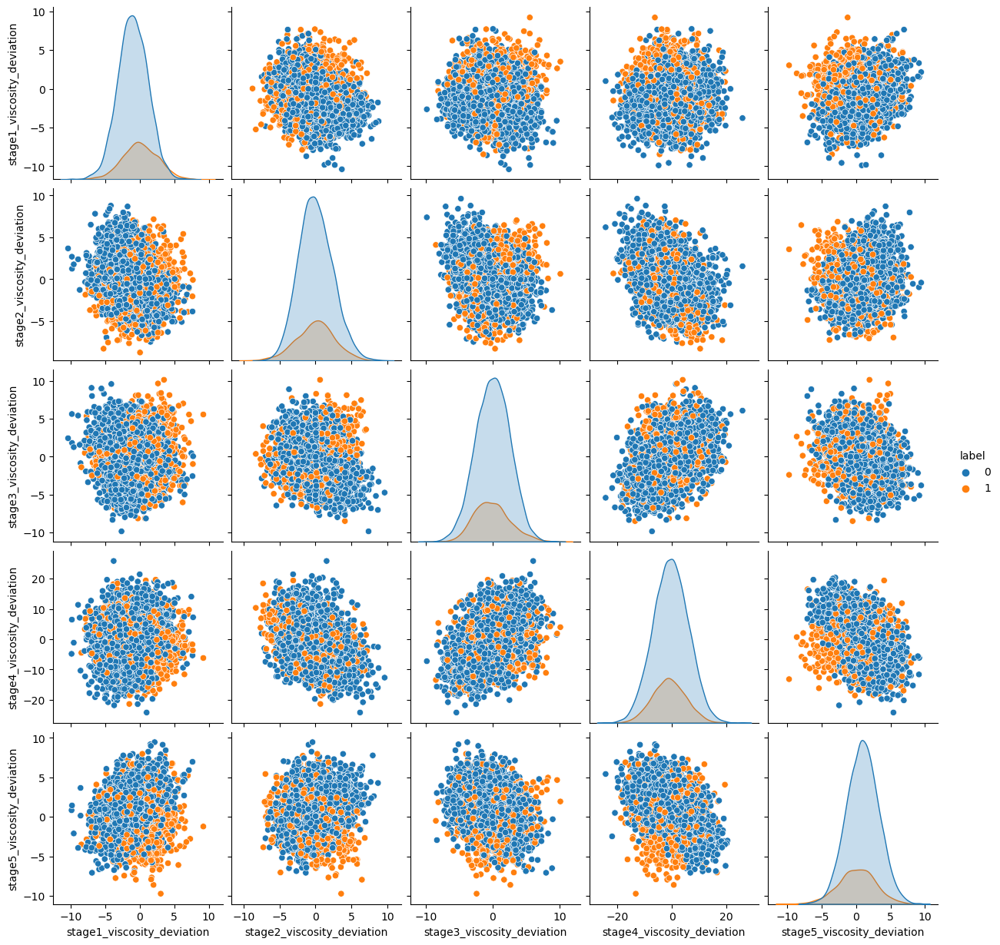

In [ ]:
sns.pairplot(train_eda[['stage1_viscosity_deviation', 'stage2_viscosity_deviation','stage3_viscosity_deviation','stage4_viscosity_deviation','stage5_viscosity_deviation', 'label']], hue='label')

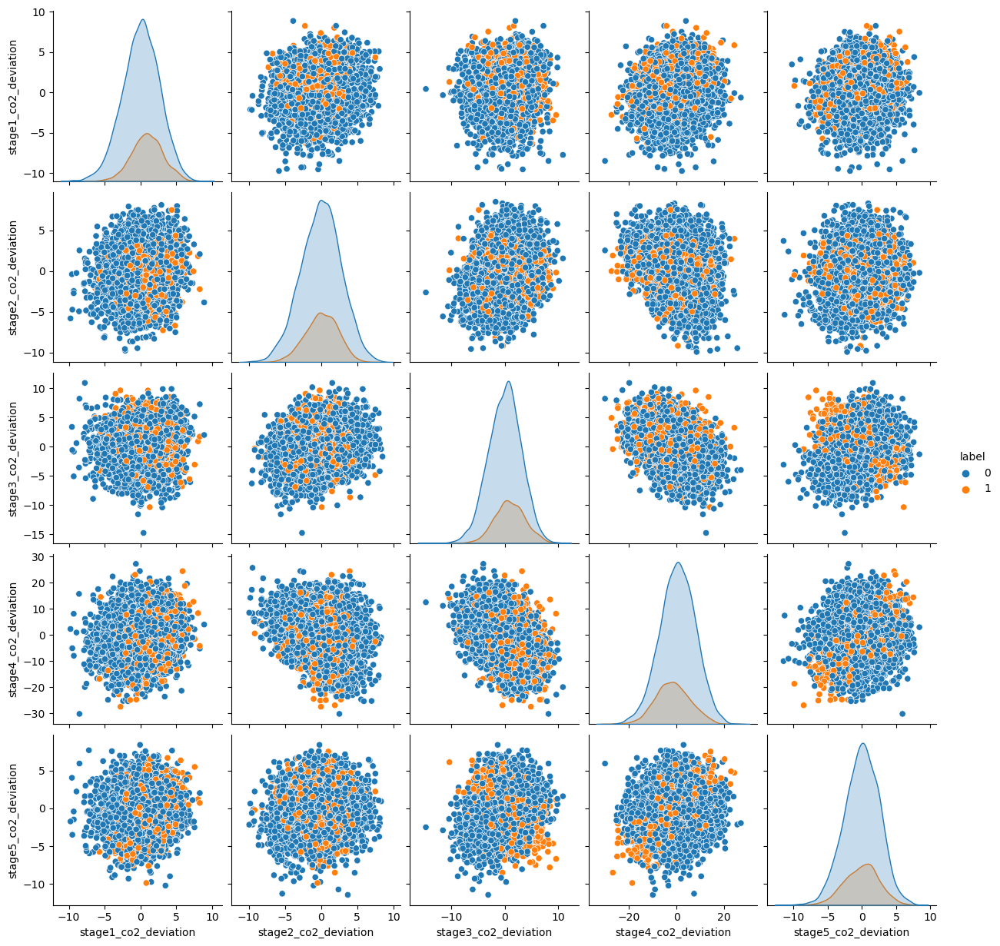

In [ ]:
sns.pairplot(train_eda[['stage1_co2_deviation', 'stage2_co2_deviation','stage3_co2_deviation','stage4_co2_deviation','stage5_co2_deviation', 'label']], hue='label')

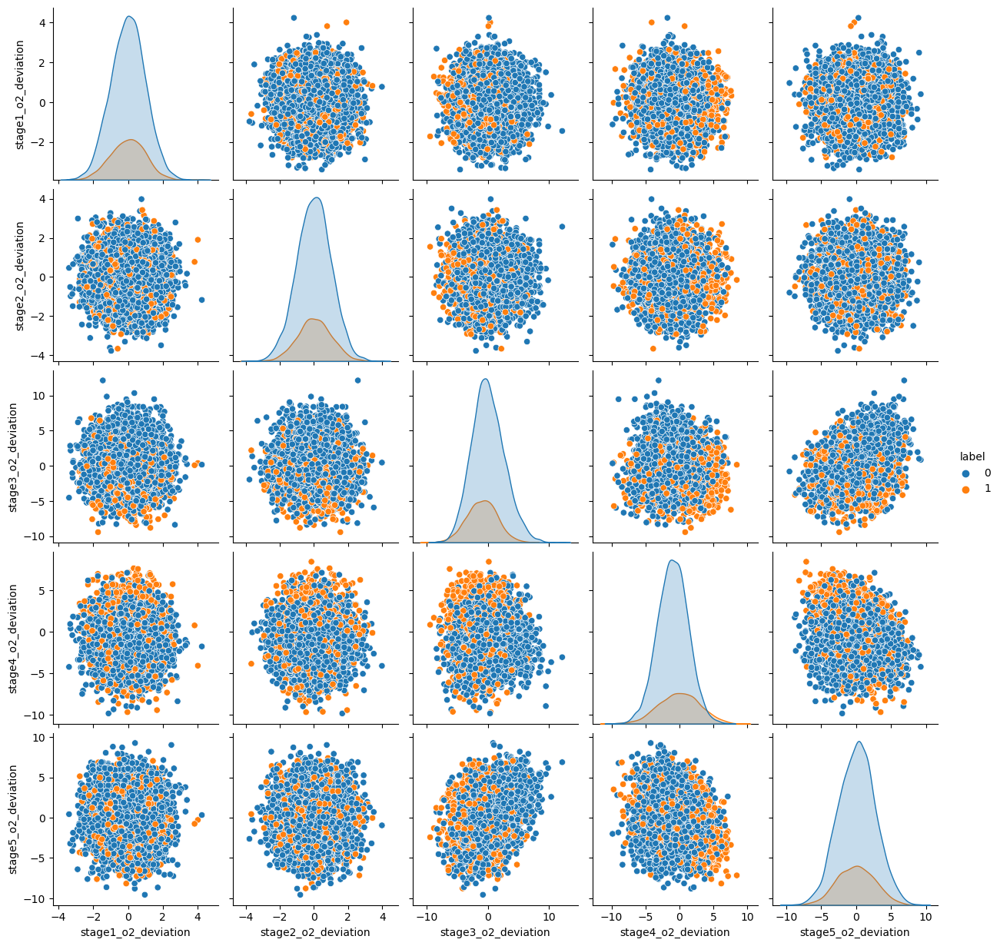

In [ ]:
sns.pairplot(train_eda[['stage1_o2_deviation', 'stage2_o2_deviation','stage3_o2_deviation','stage4_o2_deviation','stage5_o2_deviation', 'label']], hue='label')

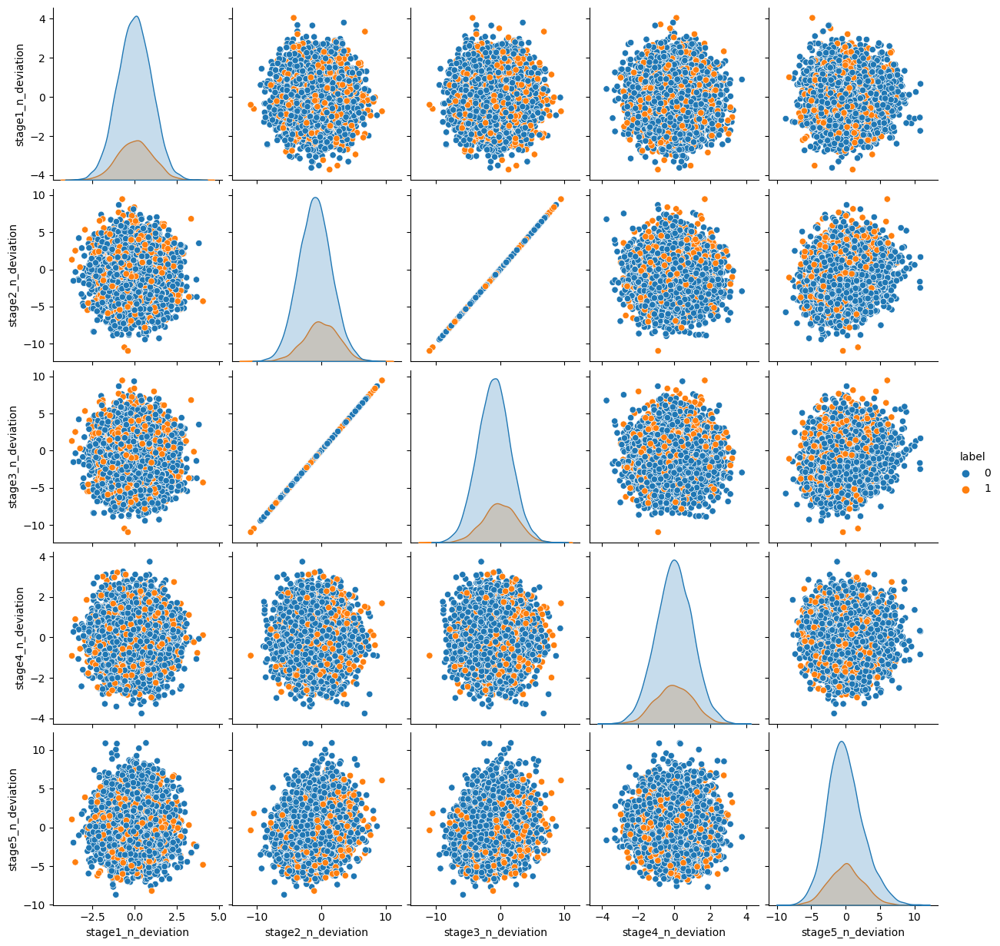

In [ ]:
sns.pairplot(train_eda[['stage1_n_deviation', 'stage2_n_deviation','stage3_n_deviation','stage4_n_deviation','stage5_n_deviation', 'label']], hue='label')

- 대부분의 공정간에는 뚜렷한 상관관계를 찾기는 어려웠다. 하지만 stage2와 stage3의 질소기체 발생 편차량은 뚜렷한 선형관계를 보였다. 따라서 모델 학습 이전에 둘중 하나를 삭제해주도록 하겠다.  
- 또한 몇몇 변수들은 분포의 외곽에 불량품 분포가 많이 몰려있는것을 파악할 수 있었다. 이는 각 변수들의 기준치인 분포 중앙에서 멀리 떨어진 이상값이 불량품을 많이 발생시킨다는 직관을 뒷받침하는 것이라고도 할 수 있다.



여기서부턴 각 stage 별로 다른 특성들끼리 어떤 상관관계가 있는지 파악해보도록 하겠다.

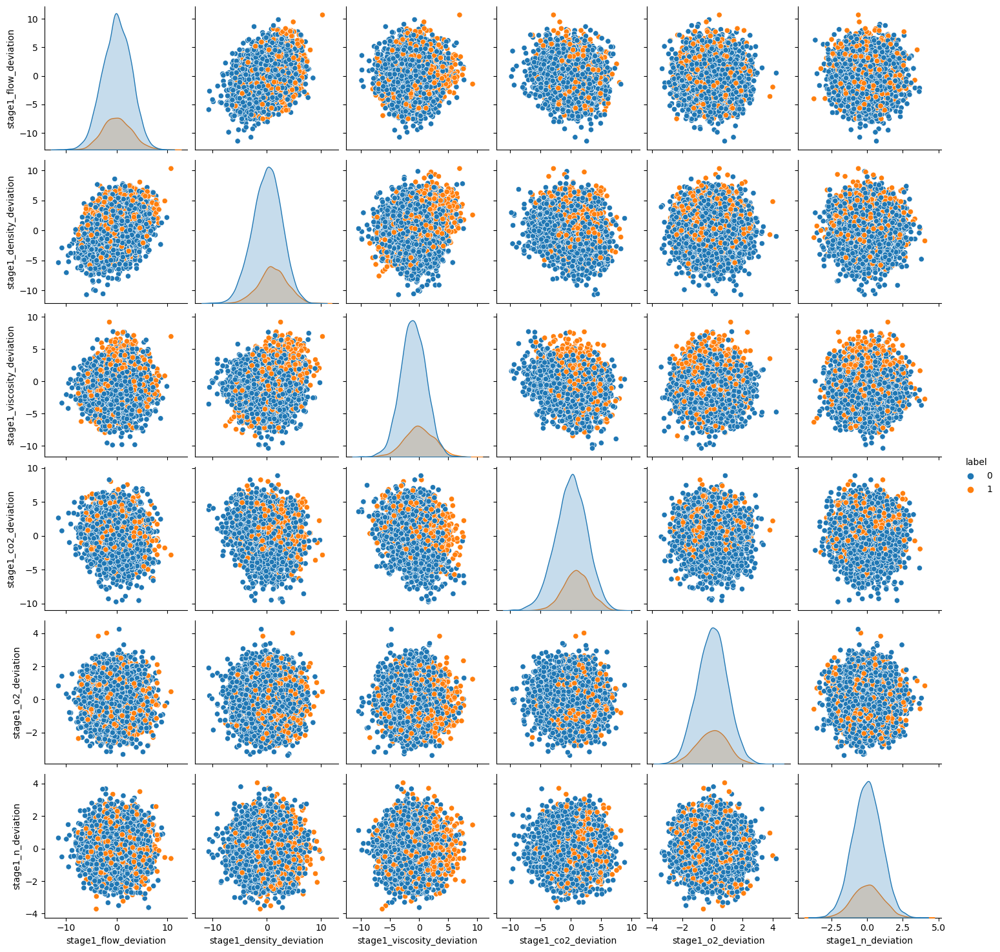

In [ ]:
sns.pairplot(train_eda[['stage1_flow_deviation','stage1_density_deviation','stage1_viscosity_deviation','stage1_co2_deviation','stage1_o2_deviation', 'stage1_n_deviation', 'label']], hue='label')

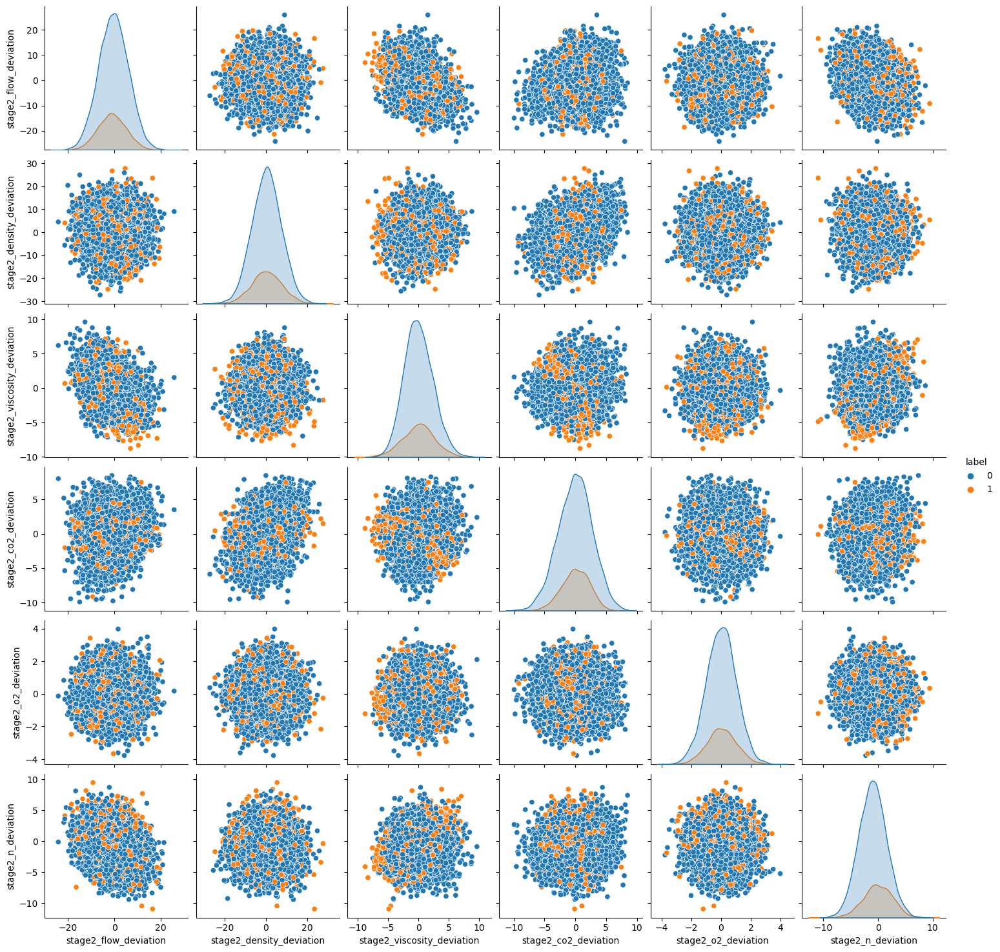

In [ ]:
sns.pairplot(train_eda[['stage2_flow_deviation','stage2_density_deviation','stage2_viscosity_deviation','stage2_co2_deviation','stage2_o2_deviation', 'stage2_n_deviation', 'label']], hue='label')

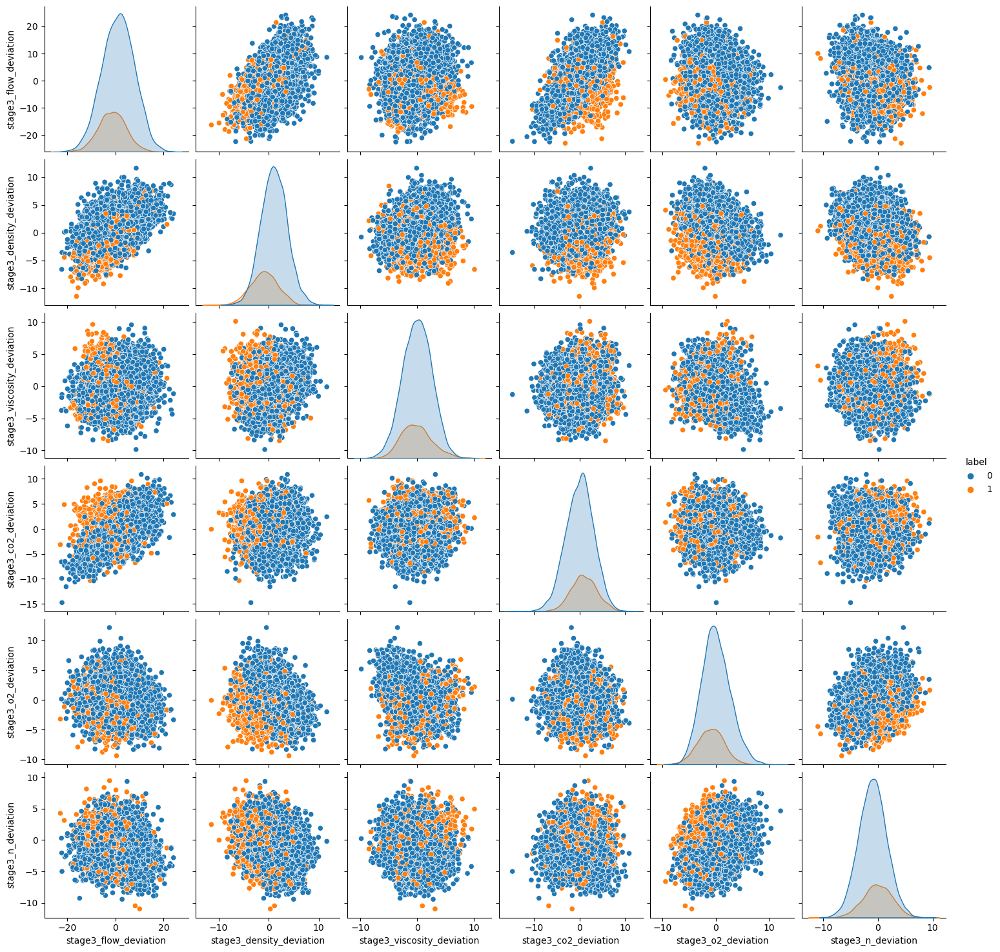

In [ ]:
sns.pairplot(train_eda[['stage3_flow_deviation','stage3_density_deviation','stage3_viscosity_deviation','stage3_co2_deviation','stage3_o2_deviation', 'stage3_n_deviation', 'label']], hue='label')

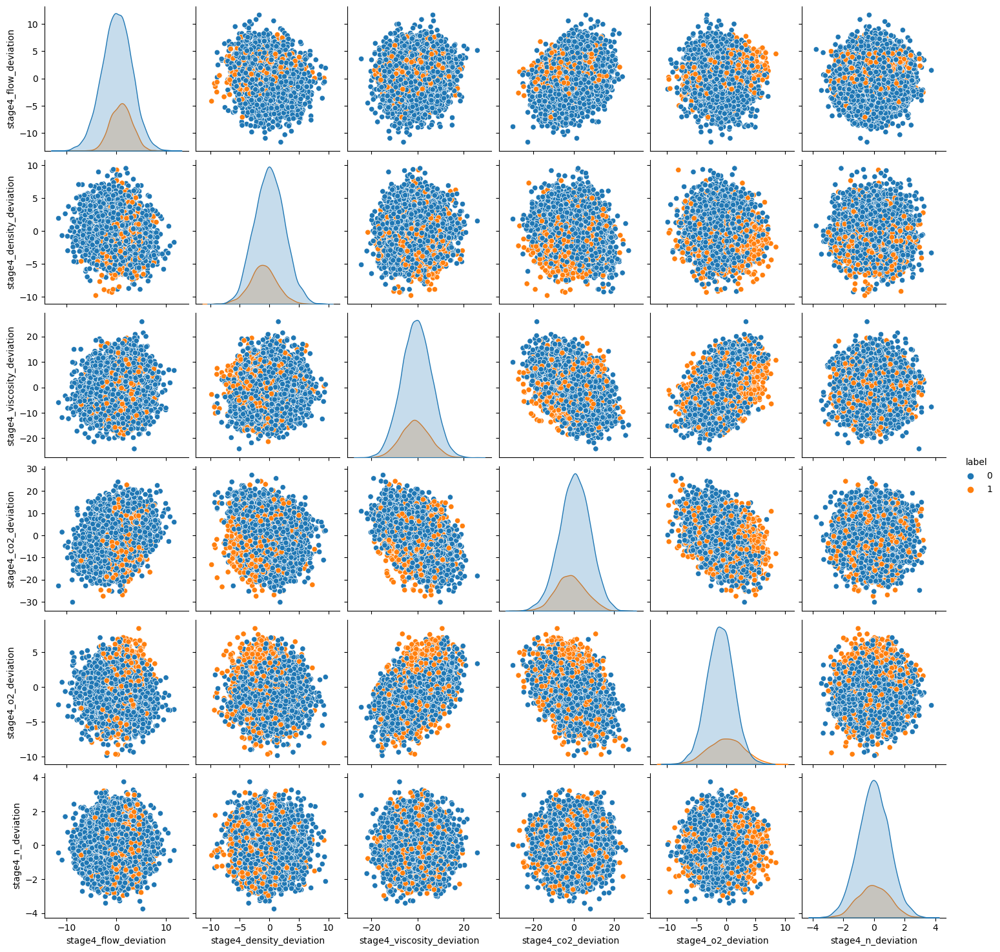

In [ ]:
sns.pairplot(train_eda[['stage4_flow_deviation','stage4_density_deviation','stage4_viscosity_deviation','stage4_co2_deviation','stage4_o2_deviation', 'stage4_n_deviation', 'label']], hue='label')

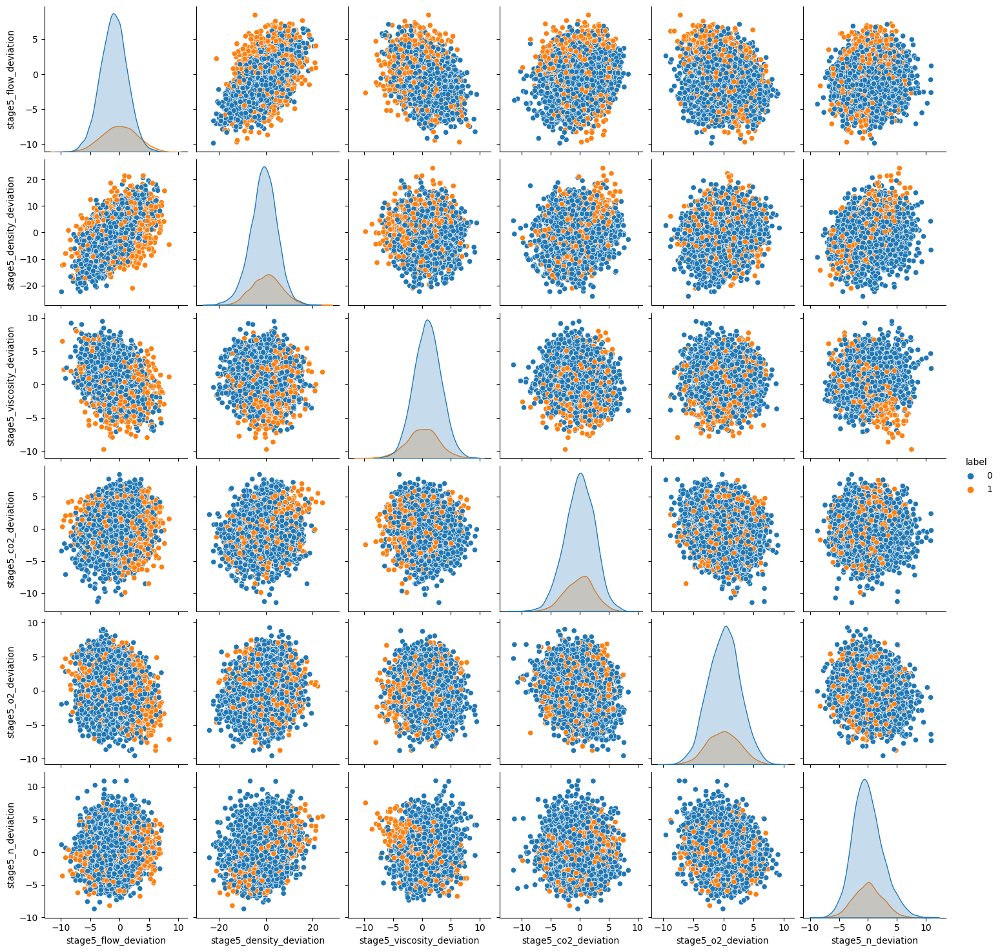

In [ ]:
sns.pairplot(train_eda[['stage5_flow_deviation','stage5_density_deviation','stage5_viscosity_deviation','stage5_co2_deviation','stage5_o2_deviation', 'stage5_n_deviation', 'label']], hue='label')

- 각 변수간에는 특별히 선형관계를 찾긴 어려웠으나 여전히 분포 외곽에 이상치가 몰려있는 분포들을 찾아볼 수 있었다. 
- 또한 특별히 분포가 skewed 되어있는 변수는 없었기에 logization을 할 필요는 없어보인다.

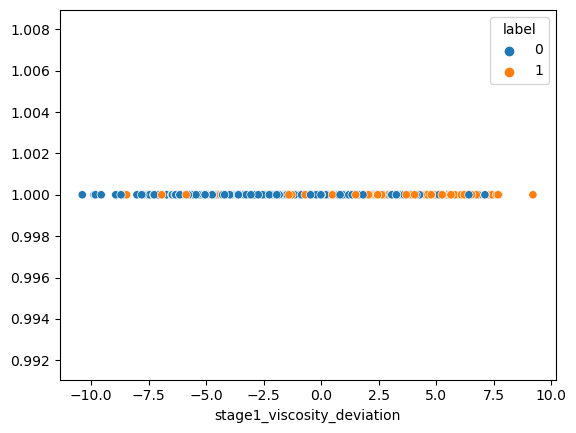

In [ ]:
# 예시1
sns.scatterplot(x=train_eda['stage1_viscosity_deviation'], y=[1]*len(train_eda), hue=train_eda['label'])
plt.show()

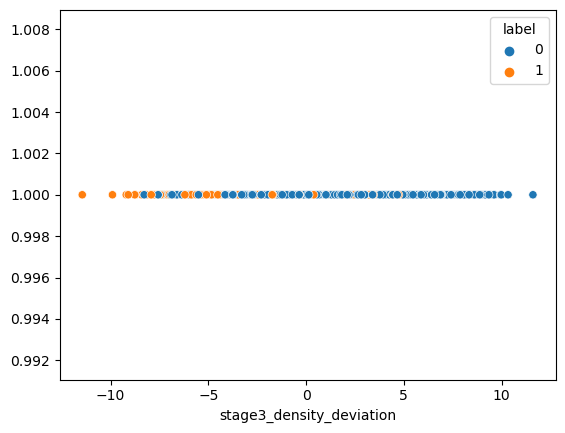

In [ ]:
# 예시2
sns.scatterplot(x=train_eda['stage3_density_deviation'], y=[1]*len(train_eda), hue=train_eda['label'])

분석 결과 feature가 이상값이나 평균보다 떨어진 지점에서 fail target이 많이 발견되는 추세를 어느정도 파악할 수 있다. 몇몇 feature는 높거나 낮은 지점에 집중적으로 몰려있기도 하다.   
한 변수에서 불량품 발생률의 경향성을 보인다면 그 반대 방향으로 제어함으로서 불량율을 제어할 수 있을지도 모른다.   
즉 쏠림을 수치적으로 보다 명확히 정량화할 수 있다면 불량을 더 잘 잡아내는 기준선을 구체화 할 수 있는 모델을 만들 수 있을것이다.

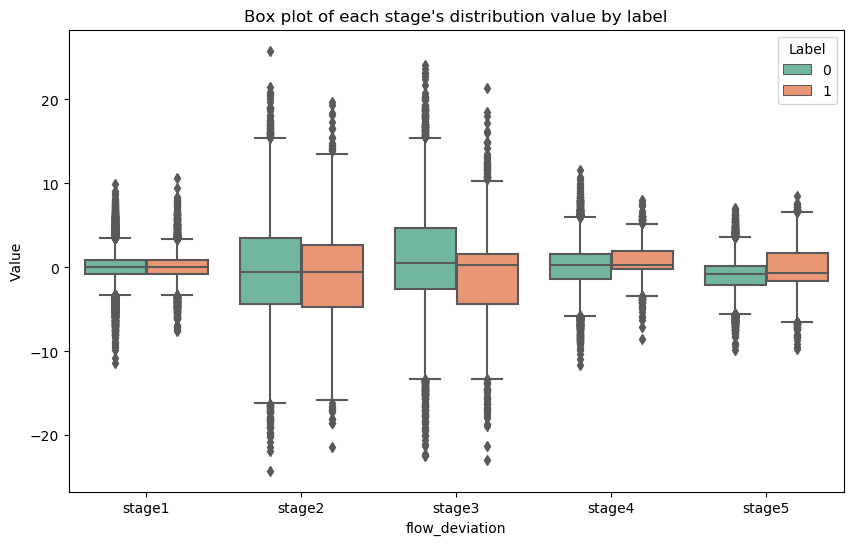

In [ ]:
train_eda2 = train_eda.fillna(train_eda.mean()).copy()

# 1. 각 stage flow_deviation과 target의 상관관계 boxplot

melted_data = pd.melt(train_eda2, id_vars=['label'], value_vars=['stage1_flow_deviation', 'stage2_flow_deviation', 'stage3_flow_deviation', 'stage4_flow_deviation', 'stage5_flow_deviation'], var_name='flow_deviation')

plt.figure(figsize=(10, 6))
sns.boxplot(x='flow_deviation', y='value', hue='label', data=melted_data, palette='Set2')
plt.xlabel('flow_deviation')
plt.ylabel('Value')
plt.xticks(range(5), ['stage1', 'stage2', 'stage3', 'stage4', 'stage5'])
plt.title('Box plot of each stage\'s distribution value by label')
plt.legend(title='Label', loc='upper right')
plt.show()

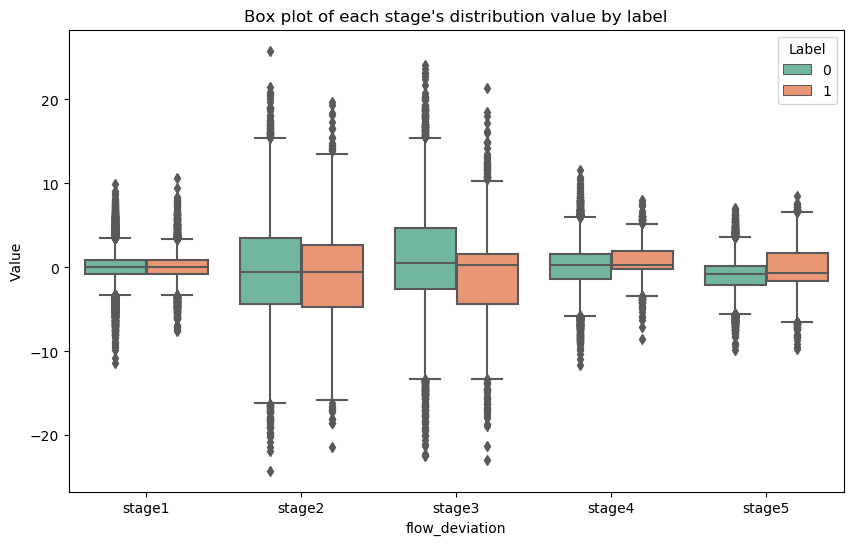

In [ ]:
# 2. 각 stage viscosity_deviation과 target의 상관관계 boxplot

melted_data = pd.melt(train_eda2, id_vars=['label'], value_vars=['stage1_flow_deviation', 'stage2_flow_deviation', 'stage3_flow_deviation', 'stage4_flow_deviation', 'stage5_flow_deviation'], var_name='flow_deviation')

plt.figure(figsize=(10, 6))
sns.boxplot(x='flow_deviation', y='value', hue='label', data=melted_data, palette='Set2')
plt.xlabel('flow_deviation')
plt.ylabel('Value')
plt.xticks(range(5), ['stage1', 'stage2', 'stage3', 'stage4', 'stage5'])
plt.title('Box plot of each stage\'s distribution value by label')
plt.legend(title='Label', loc='upper right')
plt.show()

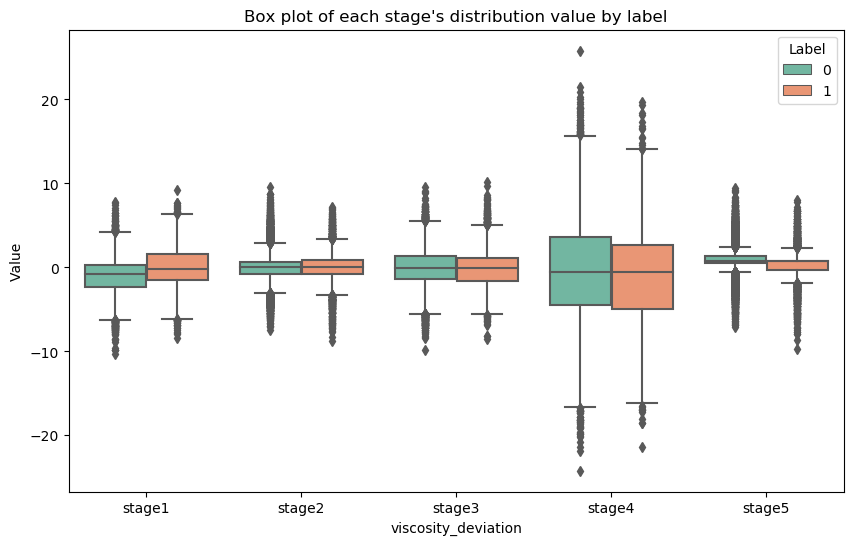

In [ ]:
# 3. 각 stage viscosity_deviation과 target의 상관관계 boxplot

melted_data = pd.melt(train_eda2, id_vars=['label'], value_vars=['stage1_viscosity_deviation', 'stage2_viscosity_deviation','stage3_viscosity_deviation','stage4_viscosity_deviation','stage5_viscosity_deviation'], var_name='viscosity_deviation')

plt.figure(figsize=(10, 6))
sns.boxplot(x='viscosity_deviation', y='value', hue='label', data=melted_data, palette='Set2')
plt.xlabel('viscosity_deviation')
plt.ylabel('Value')
plt.xticks(range(5), ['stage1', 'stage2', 'stage3', 'stage4', 'stage5'])
plt.title('Box plot of each stage\'s distribution value by label')
plt.legend(title='Label', loc='upper right')
plt.show()

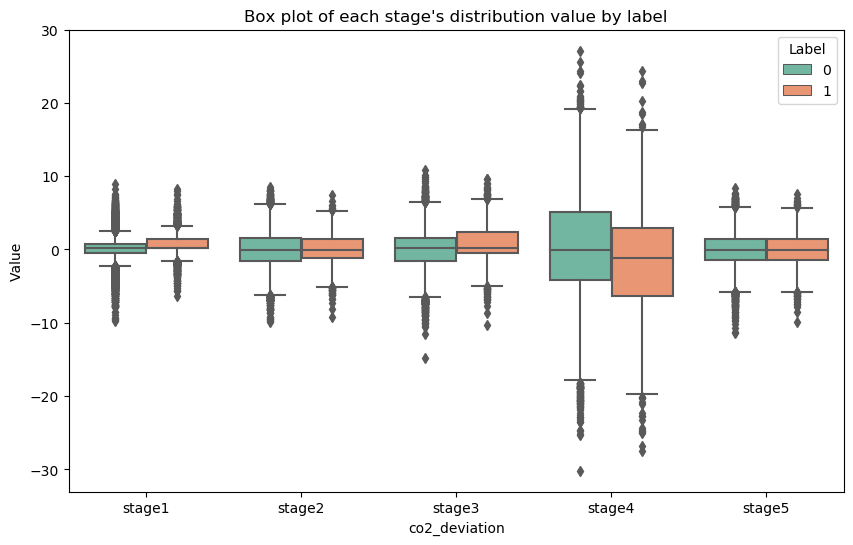

In [ ]:
# 4. 각 stage co2_deviation과 target의 상관관계 boxplot

melted_data = pd.melt(train_eda2, id_vars=['label'], value_vars=['stage1_co2_deviation', 'stage2_co2_deviation','stage3_co2_deviation','stage4_co2_deviation','stage5_co2_deviation'], var_name='co2_deviation')

plt.figure(figsize=(10, 6))
sns.boxplot(x='co2_deviation', y='value', hue='label', data=melted_data, palette='Set2')
plt.xlabel('co2_deviation')
plt.ylabel('Value')
plt.xticks(range(5), ['stage1', 'stage2', 'stage3', 'stage4', 'stage5'])
plt.title('Box plot of each stage\'s distribution value by label')
plt.legend(title='Label', loc='upper right')
plt.show()

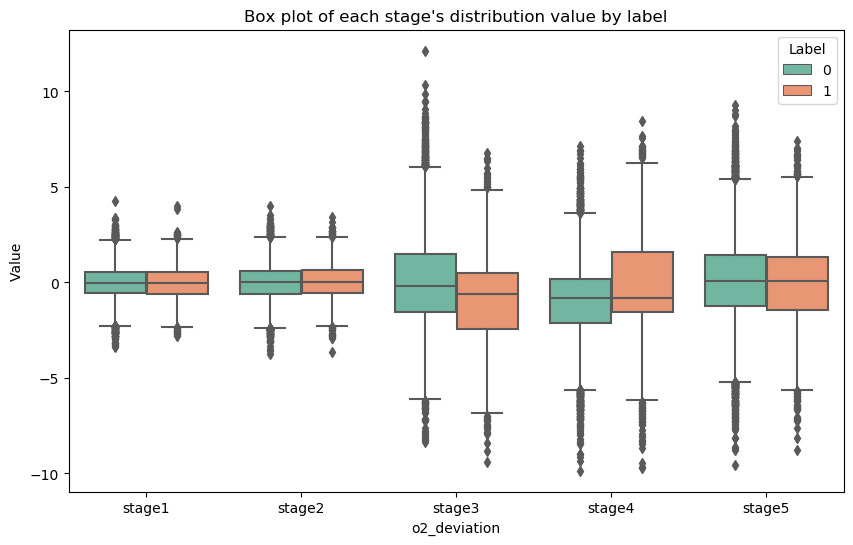

In [ ]:
# 5. 각 stage o2_deviation과 target의 상관관계 boxplot

melted_data = pd.melt(train_eda2, id_vars=['label'], value_vars=['stage1_o2_deviation', 'stage2_o2_deviation','stage3_o2_deviation','stage4_o2_deviation','stage5_o2_deviation'], var_name='o2_deviation')

plt.figure(figsize=(10, 6))
sns.boxplot(x='o2_deviation', y='value', hue='label', data=melted_data, palette='Set2')
plt.xlabel('o2_deviation')
plt.ylabel('Value')
plt.xticks(range(5), ['stage1', 'stage2', 'stage3', 'stage4', 'stage5'])
plt.title('Box plot of each stage\'s distribution value by label')
plt.legend(title='Label', loc='upper right')
plt.show()

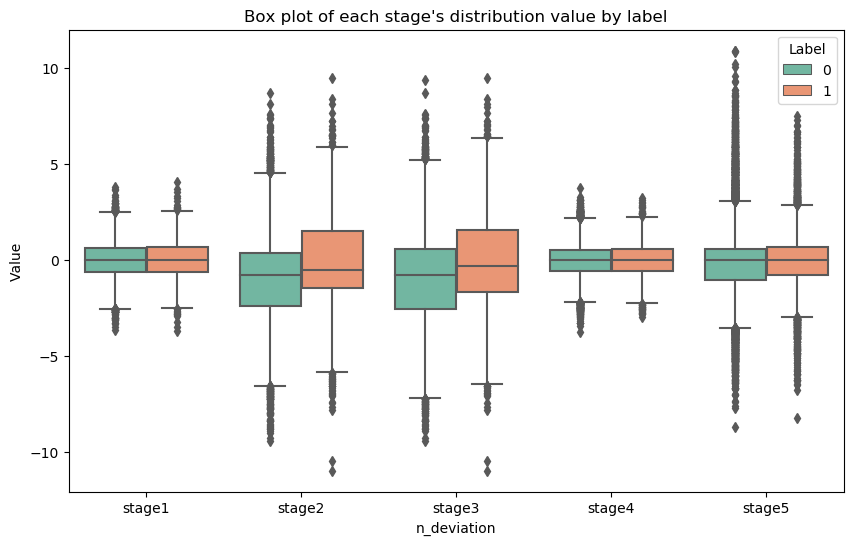

In [ ]:
# 6. 각 stage n_deviation과 target의 상관관계 boxplot

melted_data = pd.melt(train_eda2, id_vars=['label'], value_vars=['stage1_n_deviation', 'stage2_n_deviation','stage3_n_deviation','stage4_n_deviation','stage5_n_deviation'], var_name='n_deviation')

plt.figure(figsize=(10, 6))
sns.boxplot(x='n_deviation', y='value', hue='label', data=melted_data, palette='Set2')
plt.xlabel('n_deviation')
plt.ylabel('Value')
plt.xticks(range(5), ['stage1', 'stage2', 'stage3', 'stage4', 'stage5'])
plt.title('Box plot of each stage\'s distribution value by label')
plt.legend(title='Label', loc='upper right')
plt.show()

각 boxplot을 그려본 결과 양품, 불량품 간 다소간의 특성 분포차이가 보이긴 하지만 이것만으로 모든 상관관계를 고려하는건 어렵기 때문에 머신러닝이 더욱 필요하다고 판단되었다.

In [11]:
# EDA 끝나고 전처리 

# stage2_n_deviation와 강한 선형관계인 stage3_n_deviation 컬럼을 삭제

X_train.drop('stage3_n_deviation',axis=1, inplace=True)
X_val.drop('stage3_n_deviation',axis=1, inplace=True)
X_test.drop('stage3_n_deviation',axis=1, inplace=True)

- 남아있는 결측치 존재하기 때문에, 로지스틱 회귀를 사용할 경우 이를 대체해야함. 
결측치가 있는 모든 특성은 기준점(=0) 으로부터의 편차를 의미하므로 SimpleImputer를 사용해 결측치를 중앙값이나 평균으로 대체하도록 한다.  
- 모든 특성은 연속형(float) 변수이므로 별다른 encoding은 불필요

# **Part 2. ML 모델 학습 및 검증**

## **2-1. Baseline 모델 수립**


불량품과 양품의 비율은 다소 불균형하다 (불량품의 비율이 적다)  
기준 모델은 분류형에서 최빈값을 사용하였다.

In [12]:
from sklearn.metrics import f1_score

# baseline model : 최빈값
y_pred_base = [y_train.mode()[0]] * len(y_train)

baseline_accuracy = y_train.value_counts(normalize=True).max()
baseline_f1_score = f1_score(y_pred_base, y_train)

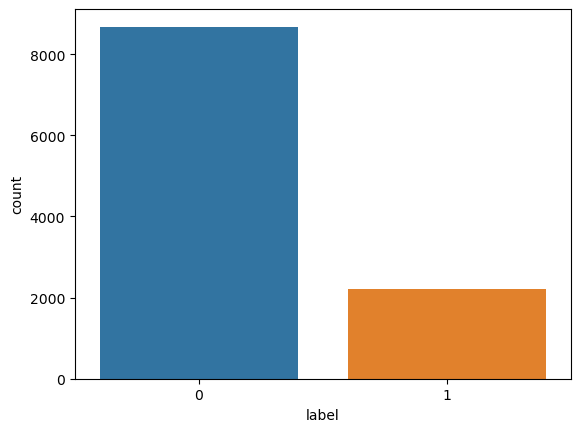

In [13]:
sns.countplot(x=y_train)

In [14]:
print('accuracy',baseline_accuracy)
print('f1_score',baseline_f1_score)

accuracy 0.7977569406140834
f1_score 0.0


<Figure size 500x300 with 0 Axes>

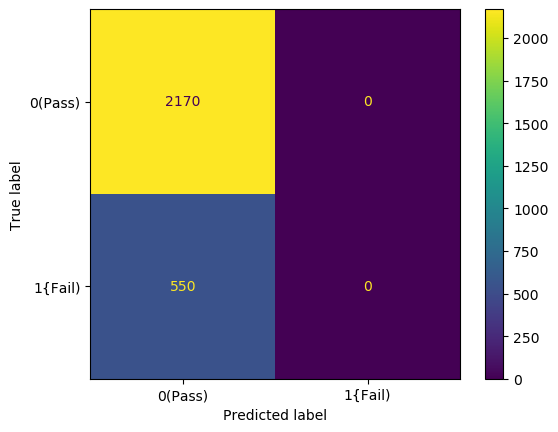

In [15]:
# baseline model로 검증 혼동행렬
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

y_val_pred_base = [y_val.mode()[0]] * len(y_val)
cm = confusion_matrix(y_val, y_val_pred_base)
plt.figure(figsize=(5, 3))
# sns.heatmap(cm, 
#             annot=True, 
#             fmt='.0f',
#             cmap='Blues',
#             cbar=False,
#             xticklabels=['0(Pass)', '1{Fail)'],
#             yticklabels=['0(Pass)', '1{Fail)'],
#             annot_kws={'size': 12})
# plt.xlabel('Predicted')
# plt.ylabel('Actual')
# plt.show();

disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=['0(Pass)', '1{Fail)'],
                              )
disp.plot()
plt.show()

최빈값은 0이며 정확도는 약 79.8%를 보여주지만 1에 대한 recall을 완전히 무시하기 때문에 f1 score는 0이다.

## **2-2. ML 모델 선정 과정 및 설명**

분류문제에 적절한 4가지 모델을 하이퍼 파라미터 튜닝없이 학습시켜 정확도와 f1 score를 비교해보고 어떤 모델을 선정할지 정하기로 하였다.

In [16]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from category_encoders import OneHotEncoder,OrdinalEncoder
from sklearn.impute import SimpleImputer

from sklearn.model_selection import cross_val_score, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import confusion_matrix, classification_report

In [ ]:
# logistic regression
lr_pipe = make_pipeline(StandardScaler(),
                        SimpleImputer(strategy='mean'),
                        LogisticRegression())

In [ ]:
# 성능 예측
cv_score = cross_val_score(lr_pipe, X_train, y_train, cv=5, scoring='accuracy')
cv_f1 = cross_val_score(lr_pipe, X_train, y_train, cv=5, scoring='f1')

# 결과 확인
print('검증 Accuracy:', cv_score.mean())
print('검증 f1 score:', cv_f1.mean())

# 결과 수집
result = {}
result2 = {}
result['Logistic Regression'] = cv_score.mean()
result2['Logistic Regression'] = cv_f1.mean()

검증 Accuracy: 0.8624751098715349
검증 f1 score: 0.5749222182410476


In [ ]:
# decision tree model
dt_pipe = make_pipeline(SimpleImputer(strategy='mean'),
                        DecisionTreeClassifier(random_state=42))

# 성능 예측
cv_score = cross_val_score(dt_pipe, X_train, y_train, cv=5)
cv_f1 = cross_val_score(dt_pipe, X_train, y_train, cv=5, scoring='f1')

# 결과 확인
print('검증 Accuracy:', cv_score.mean())
print('검증 f1 score:', cv_f1.mean())

# 결과 수집
result['Decision Tree'] = cv_score.mean()
result2['Decision Tree'] = cv_f1.mean()

검증 Accuracy: 0.8187182217714672
검증 f1 score: 0.5578931765079558


In [ ]:
# RandomForest model
rf_pipe = make_pipeline(SimpleImputer(strategy='mean'),
                        RandomForestClassifier(random_state=42))

# 성능 예측
cv_score = cross_val_score(rf_pipe, X_train, y_train, cv=5)
cv_f1 = cross_val_score(rf_pipe, X_train, y_train, cv=5, scoring='f1')

# 결과 확인
print('검증 Accuracy:', cv_score.mean())
print('검증 f1 score:', cv_f1.mean())

# 결과 수집
result['Random Forest'] = cv_score.mean()
result2['Random Forest'] = cv_f1.mean()

검증 Accuracy: 0.8946505662609873
검증 f1 score: 0.6595619263749138


In [ ]:
# xgboost model
xgb_pipe = make_pipeline(SimpleImputer(strategy='mean'),
                         XGBClassifier(random_state=42))

# 성능 예측
cv_score = cross_val_score(xgb_pipe, X_train, y_train, cv=5)
cv_f1 = cross_val_score(xgb_pipe, X_train, y_train, cv=5, scoring='f1')

# 결과 확인
print('검증 Accuracy:', cv_score.mean())
print('검증 f1 score:', cv_f1.mean())

# 결과 수집
result['XGBoost'] = cv_score.mean()
result2['XGBoost'] = cv_f1.mean()

검증 Accuracy: 0.9285718390804598
검증 f1 score: 0.8031856746407688


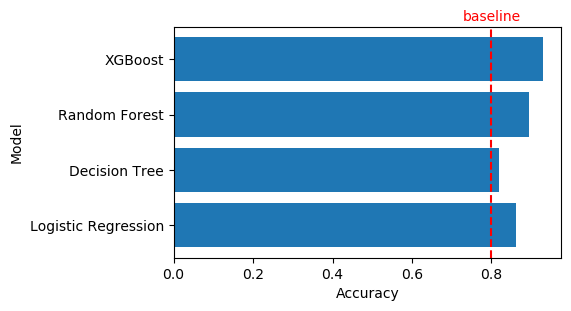

In [ ]:
# 성능 시각화(accuracy)
plt.figure(figsize=(5, 3))
plt.barh(y=list(result), width=result.values())
plt.axvline(x=baseline_accuracy, linestyle='--', color='red')
plt.text(baseline_accuracy-0.07, len(result)-0.3, 'baseline',color='red')
plt.xlabel('Accuracy')
plt.ylabel('Model')
plt.show()

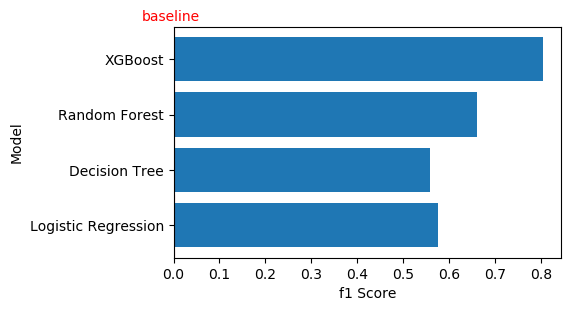

In [ ]:
# 성능 시각화(f1_score)
plt.figure(figsize=(5, 3))
plt.barh(y=list(result2), width=result2.values())
plt.axvline(x=baseline_f1_score, linestyle='--', color='red')
plt.text(baseline_f1_score-0.07, len(result2)-0.3, 'baseline',color='red')
plt.xlabel('f1 Score')
plt.ylabel('Model')
plt.show()

4가지 기본 모델 성능을 비교한 결과 Gradient Boosting model중 하나인 XGBoost를 채택하였다.   
XGboost는 잔차를 반복 학습시키면서 손실함수를 점점 최소화 해나가는 방식의 Gradient boosting 모델링 방법의 일종이다. 결정트리 모델을 기반으로 하기 때문에 결측치나 다중공선성 문제에 대해 강하면서도 앙상블 기법의 일종이라 과적합 방지에 장점이 있다.

## **2-3. 하이퍼 파라미터 튜닝**

먼저 RandomizedSearchCV를 통해 적당히 넓은 범위를 탐색한 이후  
 탐색된 범위 근처를 GridSearchCV를 통해 좀 더 정확하게 정하는 방법을 사용하였다.

In [ ]:
from scipy.stats.distributions import uniform

param = {'xgbclassifier__max_depth': [2, 4, 6, 8, 10],
        "xgbclassifier__colsample_bytree": uniform(loc=0.5, scale=0.5),
         "simpleimputer__strategy": ["median", "mean"],
         'xgbclassifier__learning_rate': [0.05, 0.10, 0.20]}

# 모델 선언
model_pipe = RandomizedSearchCV(xgb_pipe,
                                param,
                                n_iter=20,
                                cv=3,
                                scoring='f1',
                                verbose=3,
                                random_state=42)

# 모델 학습
model_pipe.fit(X_train, y_train)

Fitting 3 folds for each of 20 candidates, totalling 60 fits
[CV 1/3] END simpleimputer__strategy=median, xgbclassifier__colsample_bytree=0.8982714934301164, xgbclassifier__learning_rate=0.2, xgbclassifier__max_depth=6;, score=0.761 total time=   2.7s
[CV 2/3] END simpleimputer__strategy=median, xgbclassifier__colsample_bytree=0.8982714934301164, xgbclassifier__learning_rate=0.2, xgbclassifier__max_depth=6;, score=0.786 total time=   4.0s
[CV 3/3] END simpleimputer__strategy=median, xgbclassifier__colsample_bytree=0.8982714934301164, xgbclassifier__learning_rate=0.2, xgbclassifier__max_depth=6;, score=0.784 total time=   3.6s
[CV 1/3] END simpleimputer__strategy=mean, xgbclassifier__colsample_bytree=0.7993292420985183, xgbclassifier__learning_rate=0.2, xgbclassifier__max_depth=4;, score=0.740 total time=   1.6s
[CV 2/3] END simpleimputer__strategy=mean, xgbclassifier__colsample_bytree=0.7993292420985183, xgbclassifier__learning_rate=0.2, xgbclassifier__max_depth=4;, score=0.756 total t

RandomizedSearchCV(cv=3,
                   estimator=Pipeline(steps=[('simpleimputer', SimpleImputer()),
                                             ('xgbclassifier',
                                              XGBClassifier(base_score=None,
                                                            booster=None,
                                                            callbacks=None,
                                                            colsample_bylevel=None,
                                                            colsample_bynode=None,
                                                            colsample_bytree=None,
                                                            early_stopping_rounds=None,
                                                            enable_categorical=False,
                                                            eval_metric=None,
                                                            feature_types=None,
                                                            gamma=None,
                                                            gpu_id=None,
                                                            grow_policy=N...
                                                            predictor=None,
                                                            random_state=42, ...))]),
                   n_iter=20,
                   param_distributions={'simpleimputer__strategy': ['median',
                                                                    'mean'],
                                        'xgbclassifier__colsample_bytree': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x7f874be64640>,
                                        'xgbclassifier__learning_rate': [0.05,
                                                                         0.1,
                                                                         0.2],
                                        'xgbclassifier__max_depth': [2, 4, 6, 8,
                                                                     10]},
                   random_state=42, scoring='f1', verbose=3)

In [ ]:
# RandomizedSearchCV로 찾은 최적 파라미터, 예측 최고 성능
print(model_pipe.best_params_)
print(model_pipe.best_score_)

{'simpleimputer__strategy': 'mean', 'xgbclassifier__colsample_bytree': 0.8636359979282104, 'xgbclassifier__learning_rate': 0.2, 'xgbclassifier__max_depth': 8}
0.7880803618936683


In [ ]:
# xgboost model
xgb_pipe = make_pipeline(SimpleImputer(strategy='mean'),
                         XGBClassifier(
                             colsample_bytree=0.8636359979282104,
                             random_state=42
                             )
                         )

param = {'xgbclassifier__max_depth': range(6, 11),
         'xgbclassifier__learning_rate': [0.1, 0.15, 0.20]}

# 모델 선언
model_pipe = GridSearchCV(xgb_pipe,         
                          param,
                          cv=3,
                          scoring='f1',
                          verbose=3,)

# 학습하기
model_pipe.fit(X_train, y_train)

Fitting 3 folds for each of 15 candidates, totalling 45 fits
[CV 1/3] END xgbclassifier__learning_rate=0.1, xgbclassifier__max_depth=6;, score=0.732 total time=   4.8s
[CV 2/3] END xgbclassifier__learning_rate=0.1, xgbclassifier__max_depth=6;, score=0.745 total time=   2.5s
[CV 3/3] END xgbclassifier__learning_rate=0.1, xgbclassifier__max_depth=6;, score=0.759 total time=   2.5s
[CV 1/3] END xgbclassifier__learning_rate=0.1, xgbclassifier__max_depth=7;, score=0.741 total time=   2.9s
[CV 2/3] END xgbclassifier__learning_rate=0.1, xgbclassifier__max_depth=7;, score=0.749 total time=   5.3s
[CV 3/3] END xgbclassifier__learning_rate=0.1, xgbclassifier__max_depth=7;, score=0.774 total time=   2.9s
[CV 1/3] END xgbclassifier__learning_rate=0.1, xgbclassifier__max_depth=8;, score=0.743 total time=   3.3s
[CV 2/3] END xgbclassifier__learning_rate=0.1, xgbclassifier__max_depth=8;, score=0.757 total time=   5.7s
[CV 3/3] END xgbclassifier__learning_rate=0.1, xgbclassifier__max_depth=8;, score=0

GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('simpleimputer', SimpleImputer()),
                                       ('xgbclassifier',
                                        XGBClassifier(base_score=None,
                                                      booster=None,
                                                      callbacks=None,
                                                      colsample_bylevel=None,
                                                      colsample_bynode=None,
                                                      colsample_bytree=0.8636359979282104,
                                                      early_stopping_rounds=None,
                                                      enable_categorical=False,
                                                      eval_metric=None,
                                                      feature_types=None,
                                                      gamma=None, gpu_id=None,
                                                      grow_...
                                                      max_cat_threshold=None,
                                                      max_cat_to_onehot=None,
                                                      max_delta_step=None,
                                                      max_depth=None,
                                                      max_leaves=None,
                                                      min_child_weight=None,
                                                      missing=nan,
                                                      monotone_constraints=None,
                                                      n_estimators=100,
                                                      n_jobs=None,
                                                      num_parallel_tree=None,
                                                      predictor=None,
                                                      random_state=42, ...))]),
             param_grid={'xgbclassifier__learning_rate': [0.1, 0.15, 0.2],
                         'xgbclassifier__max_depth': range(6, 11)},
             scoring='f1', verbose=3)

In [ ]:
# GridSearchCV로 찾은 최적 파라미터, 예측 최고 성능
print(model_pipe.best_params_)
print(model_pipe.best_score_)

{'xgbclassifier__learning_rate': 0.2, 'xgbclassifier__max_depth': 9}
0.7889334414412881


**조정된 하이퍼 파라미터**   
- simpleimputer__strategy : "mean" (결측치를 어떤 값으로 채울지 결정)  
- max_depth : 9 (트리의 최대 깊이, 과적합에 관여)  
- learning_rate : 0.2 (학습률, 모델의 학습속도, 과적합에 관여)  
- colsample_bytree : 0.8636359979282104 (트리를 생성하는 feature의 샘플링 비율, 과적합에 관여)


In [17]:
# 하이퍼 파라미터 튜닝을 통해 선정된 모델

xgb_pipe2 = make_pipeline(SimpleImputer(strategy='mean'),
                         XGBClassifier(
                             max_depth=9,
                             colsample_bytree=0.8636359979282104,
                             learning_rate=0.2,
                             random_state=42,
                             )
                         )

# 성능 예측
cv_score = cross_val_score(xgb_pipe2, X_train, y_train, cv=5)
cv_f1 = cross_val_score(xgb_pipe2, X_train, y_train, cv=5, scoring='f1')

# 결과 확인
print('검증 Accuracy:', cv_score.mean())
print('검증 f1 score:', cv_f1.mean())

검증 Accuracy: 0.9263655341446924
검증 f1 score: 0.7925706317767941


## **2-4. 검증 및 일반화 성능 확인**

target 분포에 약간의 불균형이 있었기에  
 undersampling, oversampling, smote sampling 및 class weight 조절을 통해 불량품의 recall값을 개선할 수 있는지 확인해보았다.

In [ ]:
# No sampling

xgb_pipe2.fit(X_train, y_train)
y_val_pred = xgb_pipe2.predict(X_val)
print(confusion_matrix(y_val, y_val_pred))
print(classification_report(y_val, y_val_pred))

[[2146   24]
 [ 162  388]]
              precision    recall  f1-score   support

           0       0.93      0.99      0.96      2170
           1       0.94      0.71      0.81       550

    accuracy                           0.93      2720
   macro avg       0.94      0.85      0.88      2720
weighted avg       0.93      0.93      0.93      2720



In [18]:
from imblearn.under_sampling import RandomUnderSampler # down
from imblearn.over_sampling import RandomOverSampler, SMOTE  # up, smote

# 다운샘플링
rus = RandomUnderSampler(random_state = 42)
X_train_d, y_train_d = rus.fit_resample(X_train, y_train)

# 업샘플링
ros = RandomOverSampler(random_state = 42)
X_train_u, y_train_u = ros.fit_resample(X_train, y_train)

# SMOTE
imputer = SimpleImputer(strategy='mean')
X_train_impute = imputer.fit_transform(X_train)

smote = SMOTE(random_state = 42)
X_train_sm, y_train_sm = smote.fit_resample(X_train_impute, y_train)

In [ ]:
# DOWN sampling

xgb_pipe2.fit(X_train_d, y_train_d)
y_val_pred_d = xgb_pipe2.predict(X_val)
print(confusion_matrix(y_val, y_val_pred_d))
print(classification_report(y_val, y_val_pred_d))

[[1979  191]
 [  56  494]]
              precision    recall  f1-score   support

           0       0.97      0.91      0.94      2170
           1       0.72      0.90      0.80       550

    accuracy                           0.91      2720
   macro avg       0.85      0.91      0.87      2720
weighted avg       0.92      0.91      0.91      2720



In [ ]:
# UP sampling

xgb_pipe2.fit(X_train_u, y_train_u)
y_val_pred_u = xgb_pipe2.predict(X_val)
print(confusion_matrix(y_val, y_val_pred_u))
print(classification_report(y_val, y_val_pred_u))

[[2118   52]
 [ 121  429]]
              precision    recall  f1-score   support

           0       0.95      0.98      0.96      2170
           1       0.89      0.78      0.83       550

    accuracy                           0.94      2720
   macro avg       0.92      0.88      0.90      2720
weighted avg       0.94      0.94      0.93      2720



In [ ]:
# SMOTE sampling

xgb_pipe2.fit(X_train_sm, y_train_sm)
y_val_pred_sm = xgb_pipe2.predict(X_val)
print(confusion_matrix(y_val, y_val_pred_sm))
print(classification_report(y_val, y_val_pred_sm))

[[1861  309]
 [  35  515]]
              precision    recall  f1-score   support

           0       0.98      0.86      0.92      2170
           1       0.62      0.94      0.75       550

    accuracy                           0.87      2720
   macro avg       0.80      0.90      0.83      2720
weighted avg       0.91      0.87      0.88      2720



In [ ]:
# class weight 조절 (pos)
xgb_pipe2_wb = make_pipeline(SimpleImputer(strategy='mean'),
                         XGBClassifier(
                             max_depth=9,
                             colsample_bytree=0.8636359979282104,
                             learning_rate=0.2,
                             random_state=42,
                             scale_pos_weight=(y_val == 0).sum() / (y_val == 1).sum(), # class weight 조절
                             )
                         )

xgb_pipe2_wb.fit(X_train, y_train)
pred_wb = xgb_pipe2_wb.predict(X_val)

print(confusion_matrix(y_val, pred_wb))
print(classification_report(y_val, pred_wb))

[[2122   48]
 [ 114  436]]
              precision    recall  f1-score   support

           0       0.95      0.98      0.96      2170
           1       0.90      0.79      0.84       550

    accuracy                           0.94      2720
   macro avg       0.92      0.89      0.90      2720
weighted avg       0.94      0.94      0.94      2720



SMOTE Sampling을 수행했을 때 모델 전체의 f1_score는 다소 하락하였으나,
불량품에 대한 Recall값이 0.94로 제일 높았다. 좀 더 일반화된 성능을 확인하고자 for문으로 train set 내부에서 무작위로 validation set을 추출하여 f1 score와 recall값을 확인하기로 하였다.

In [19]:
imputer = SimpleImputer(strategy='mean')
X_train_impute = imputer.fit_transform(X_train)
X_val_impute = imputer.transform(X_val)

In [ ]:
# xgboost로 모델링 및 검증(f1 score)하는 함수 생성
def xgb_modeling(X_train, y_train, X_val, y_val, cw = None) :
    m = XGBClassifier(max_depth=9,
                      colsample_bytree=0.8636359979282104,
                      learning_rate=0.2,
                      random_state=42,
                      scale_pos_weight = cw)
    m.fit(X_train, y_train)
    pred = m.predict(X_val)
    return f1_score(y_val,pred, pos_label=1), recall_score(y_val, pred, pos_label=1) # 1 : 불량품

In [ ]:
from tqdm import tqdm
from sklearn.metrics import recall_score

In [ ]:
# 결과를 담을 빈 리스트 선언
result_d, result_u, result_s, result_cw = [], [], [], []
recall_d, recall_u, recall_s, recall_cw = [], [], [], []

# 리샘플러들 선언
down_sampler = RandomUnderSampler()
up_sampler = RandomOverSampler()
smote = SMOTE()

# 20번 반복
for i in tqdm(range(20)):

    # 데이터분할 & 리샘플링(랜덤하게!!!!)
    X_train2, X_val2, y_train2, y_val2 = train_test_split(X_train_impute, y_train, test_size = 0.2)
    d_x_train, d_y_train = down_sampler.fit_resample(X_train2, y_train2)
    u_x_train, u_y_train = up_sampler.fit_resample(X_train2, y_train2)
    s_x_train, s_y_train = smote.fit_resample(X_train2, y_train2)

    # 모델링 및 검증성능(f1, recall) 저장하기
    result_d.append(xgb_modeling(d_x_train, d_y_train, X_val2, y_val2)[0])
    result_u.append(xgb_modeling(u_x_train, u_y_train, X_val2, y_val2)[0])
    result_s.append(xgb_modeling(s_x_train, s_y_train, X_val2, y_val2)[0])
    result_cw.append(xgb_modeling(X_train2, y_train2, X_val2, y_val2, (y_val2 == 0).sum() / (y_val2 == 1).sum())[0])

    recall_d.append(xgb_modeling(d_x_train, d_y_train, X_val2, y_val2)[1])
    recall_u.append(xgb_modeling(u_x_train, u_y_train, X_val2, y_val2)[1])
    recall_s.append(xgb_modeling(s_x_train, s_y_train, X_val2, y_val2)[1])
    recall_cw.append(xgb_modeling(X_train2, y_train2, X_val2, y_val2, (y_val2 == 0).sum() / (y_val2 == 1).sum())[1])

100%|██████████| 20/20 [15:02<00:00, 45.15s/it]


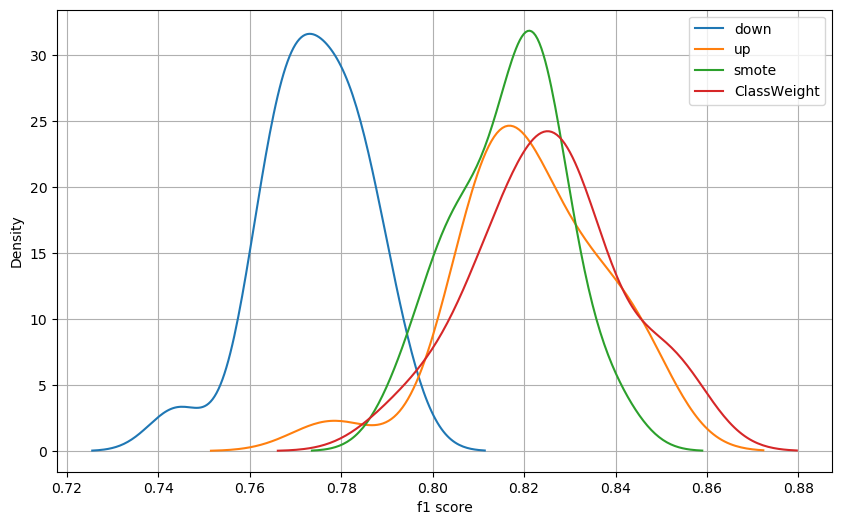

In [ ]:
# f1 score ploting

plt.figure(figsize=(10, 6))
sns.kdeplot(result_d, label= 'down')
sns.kdeplot(result_u, label = 'up')
sns.kdeplot(result_s, label = 'smote' )
sns.kdeplot(result_cw, label = 'ClassWeight' )

plt.xlabel('f1 score')
plt.legend()
plt.grid()
plt.show()

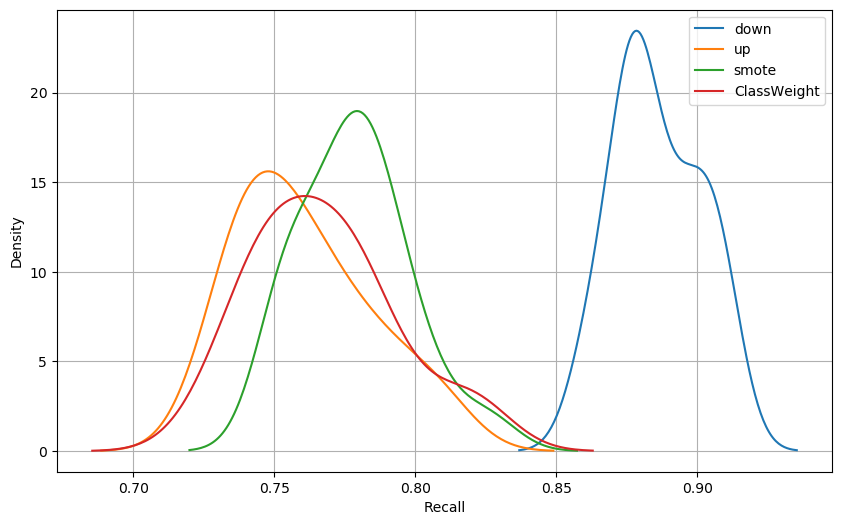

In [ ]:
# recall score ploting

plt.figure(figsize=(10, 6))
sns.kdeplot(recall_d, label= 'down')
sns.kdeplot(recall_u, label = 'up')
sns.kdeplot(recall_s, label = 'smote' )
sns.kdeplot(recall_cw, label = 'ClassWeight')

plt.xlabel('Recall')
plt.legend()
plt.grid()
plt.show()

train set 내부에서 validation을 랜덤하게 추출해서 일반화 성능을 확인해본 결과 아까와 달리
- f1 score는 upsampling할 때와, scale_pos_weight로 가중치를 두었을때가 비슷하게 높았고, Recall은 down sampling일때 가장 우수한 값을 보였다. 
- 반대로 down sampling일때 f1 score는 제일 낮게 나왔으므로 그만큼 Precsion값을 희생해야 한
- 이번 프로젝트의 목적은 불량품을 잘 잡아내는 것에 있으므로 1의 Recall값이 우수한 down sampling을 선택하였다.
- 즉 양품을 일부 희생시키더라도 불량품을 양품으로 판정하는것을 막아야 반도체의 신뢰성을 향상시킬 수 있다고 판단하였다.

In [20]:
# 최종 Test전 Vaildation set 에 대한 평가

xgb_pipe2.fit(X_train_d, y_train_d)
y_val_pred_d = xgb_pipe2.predict(X_val)
print(confusion_matrix(y_val, y_val_pred_d))
print(classification_report(y_val, y_val_pred_d))

[[1979  191]
 [  56  494]]
              precision    recall  f1-score   support

           0       0.97      0.91      0.94      2170
           1       0.72      0.90      0.80       550

    accuracy                           0.91      2720
   macro avg       0.85      0.91      0.87      2720
weighted avg       0.92      0.91      0.91      2720



<Figure size 500x300 with 0 Axes>

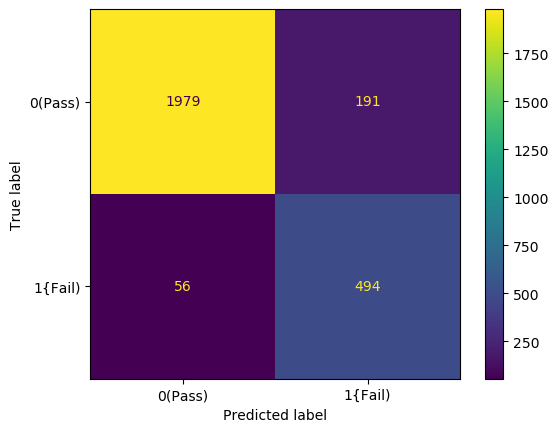

In [22]:
cm1 = confusion_matrix(y_val, y_val_pred_d)
plt.figure(figsize=(5, 3))
disp = ConfusionMatrixDisplay(confusion_matrix=cm1,
                              display_labels=['0(Pass)', '1{Fail)'],
                              )
disp.plot()
plt.show()

Test set에 대한 모델의 정확도는 약 91%, 1에 대한 f1_score는 약 0.80, Recall은 약 0.90을 달성하였으며 과적합은 발생하지 않은 것으로 보인다.

In [23]:
# 최종 Test set에 대한 평가

#xgb_pipe2.fit(X_train_d, y_train_d)
y_test_pred_d = xgb_pipe2.predict(X_test)
print(confusion_matrix(y_test, y_test_pred_d))
print(classification_report(y_test, y_test_pred_d))

[[2429  284]
 [  68  619]]
              precision    recall  f1-score   support

           0       0.97      0.90      0.93      2713
           1       0.69      0.90      0.78       687

    accuracy                           0.90      3400
   macro avg       0.83      0.90      0.86      3400
weighted avg       0.91      0.90      0.90      3400



<Figure size 500x300 with 0 Axes>

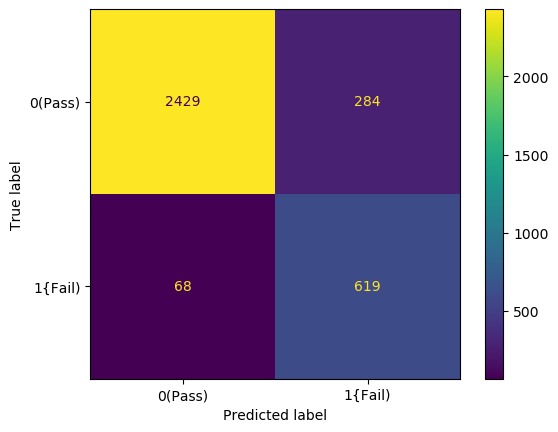

In [24]:
cm2 = confusion_matrix(y_test, y_test_pred_d)
plt.figure(figsize=(5, 3))
disp = ConfusionMatrixDisplay(confusion_matrix=cm2,
                              display_labels=['0(Pass)', '1{Fail)'],
                              )
disp.plot()
plt.show()

Test set에 대한 모델의 정확도는 약 90%, 1에 대한 f1_score는 약 0.78, Recall은 약 0.90을 달성하였다. Validation과 큰 차이가 없는 것으로 보아 일반화 성능을 충족시킨 것으로 판단된다.

# **Part 3. 모델 해석 및 결론**

## **3-1. 변수 중요도 확인**

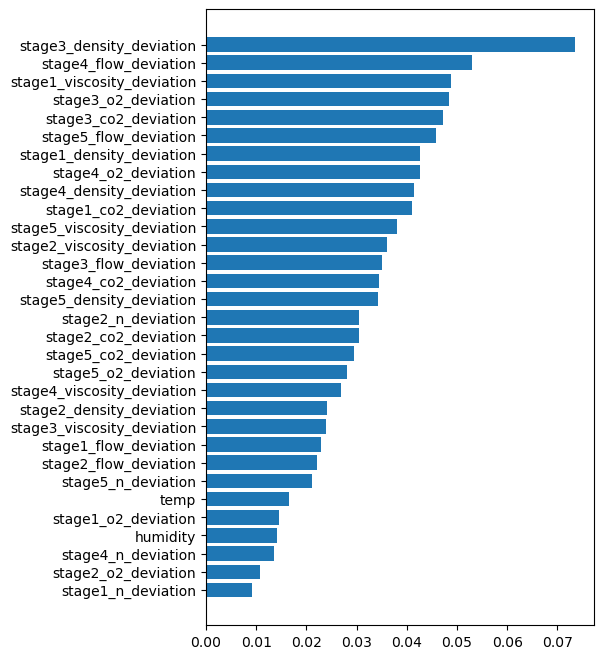

In [ ]:
# 변수 중요도 시각화
tmp = pd.DataFrame()

tmp['feature'] = list(X_train)
tmp['importance'] = xgb_pipe2[-1].feature_importances_
tmp.sort_values(by='importance', inplace=True)

plt.figure(figsize=(5, 8))
plt.barh(y=tmp['feature'], width=tmp['importance'] )
plt.show()

In [ ]:
from eli5.sklearn import PermutationImportance

# permuter 정의
permuter = PermutationImportance(
    xgb_pipe2[-1],  # model
    scoring="recall",  # metric
    n_iter=10,  # 다른 random seed를 사용하여 10번 반복
    random_state=42,
)

# 스코어를 다시 계산합니다.
X_val_preprocessed = xgb_pipe2[0].transform(X_val)
permuter.fit(X_val_preprocessed, y_val)

PermutationImportance(estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                              callbacks=None,
                                              colsample_bylevel=1,
                                              colsample_bynode=1,
                                              colsample_bytree=0.8636359979282104,
                                              early_stopping_rounds=None,
                                              enable_categorical=False,
                                              eval_metric=None,
                                              feature_types=None, gamma=0,
                                              gpu_id=-1,
                                              grow_policy='depthwise',
                                              importance_type=None,
                                              interaction_constraints='',
                                              learning_rate=0.2, max_bin=256,
                                              max_cat_threshold=64,
                                              max_cat_to_onehot=4,
                                              max_delta_step=0, max_depth=9,
                                              max_leaves=0, min_child_weight=1,
                                              missing=nan,
                                              monotone_constraints='()',
                                              n_estimators=100, n_jobs=0,
                                              num_parallel_tree=1,
                                              predictor='auto', random_state=42, ...),
                      n_iter=10, random_state=42, scoring='recall')

Text(0.5, 1.0, 'Permutation Importance')

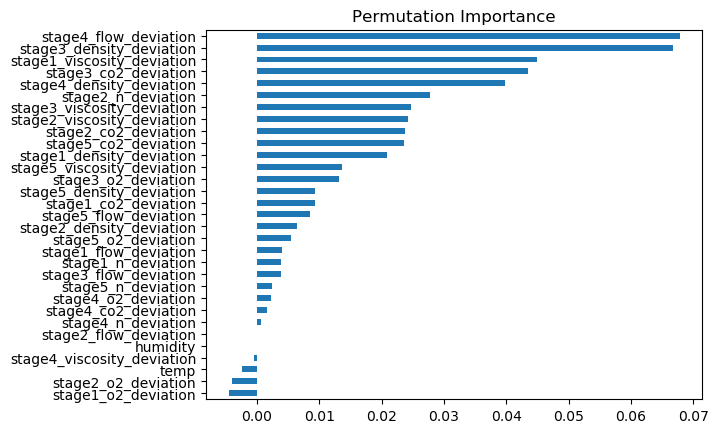

In [ ]:
feature_names = X_test.columns.tolist()
pi = pd.Series(permuter.feature_importances_, feature_names).sort_values()
pi.plot.barh()
plt.title("Permutation Importance")

In [ ]:
import eli5

# 특성별 score을 확인합니다.
eli5.show_weights(
    permuter,
    top=None,  # top n 지정 가능, None 일 경우 모든 특성
    feature_names=feature_names,  # list 형식으로 넣어야 합니다
)

Weight,Feature
0.0678 ± 0.0254,stage4_flow_deviation
0.0667 ± 0.0235,stage3_density_deviation
0.0449 ± 0.0115,stage1_viscosity_deviation
0.0435 ± 0.0176,stage3_co2_deviation
0.0398 ± 0.0214,stage4_density_deviation
0.0278 ± 0.0137,stage2_n_deviation
0.0247 ± 0.0114,stage3_viscosity_deviation
0.0242 ± 0.0089,stage2_viscosity_deviation
0.0238 ± 0.0095,stage2_co2_deviation
0.0236 ± 0.0114,stage5_co2_deviation


- `stage4_flow_deviation`, `stage3_density_deviation`, `stage1_viscosity_deviation`, `stage3_co2_deviation`, `stage4_density_deviation` 순으로 모델 성능에 큰 영향을 주는 요소라고 할 수 있다.
- 반대로 아래의 `temp`, `stage2_o2_deviation`, `stage1_o2_deviation` 등은 모델 성능과 큰 관계가 없을 가능성이 높다.

##**3-2. 주요 변수 변화로 인한 수율 변동 예측** 

Elbow Method로 선정한 중요도 상위 5개 변수에 대해 PDP Plot을 그려 모델이 변수의 변화에 따라 target 예측이 어떻게 변화하는지 살펴보겠다.

In [ ]:
from pdpbox.pdp import pdp_isolate, pdp_plot

In [ ]:
X_val_impute_df = pd.DataFrame(X_val_impute, columns=X_val.columns) # 결측값 평균으로 채운 validation set

(<Figure size 1500x950 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb8d1220>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb8e7fd0>})

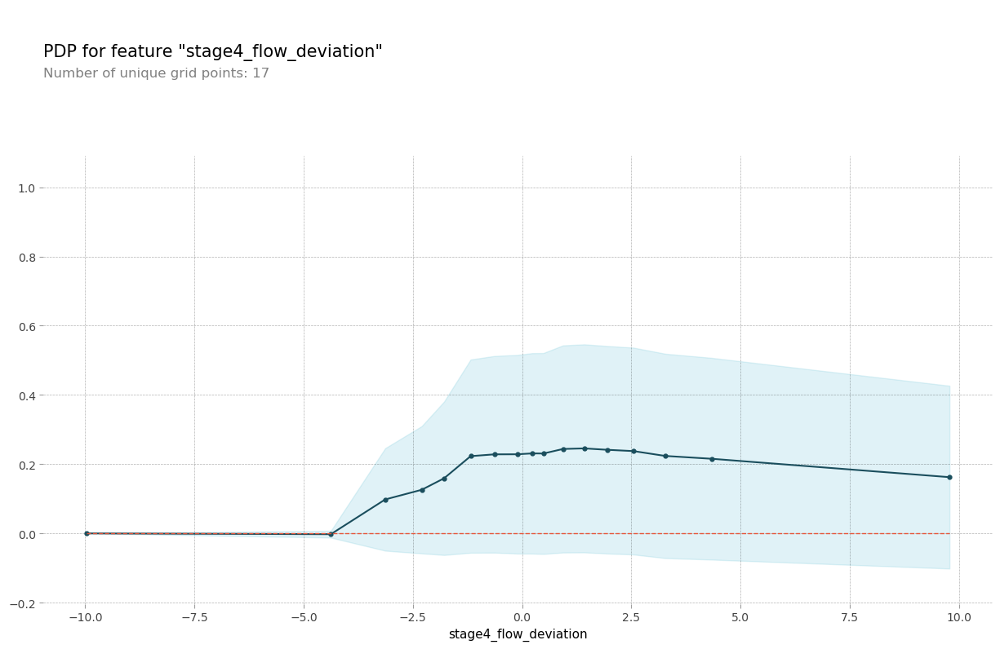

In [ ]:
target_feature = "stage4_flow_deviation"

isolated = pdp_isolate(
    model=xgb_pipe2[-1],
    dataset=X_val_impute_df,
    model_features=X_val_impute_df.columns,
    feature=target_feature,
    grid_type="percentile",  # default = 'percentile', or 'equal'
    num_grid_points=20,  # default = 10
)
pdp_plot(isolated, feature_name=target_feature)

stage4 약품의 유량이 기준치보다 -5 이상 적을수록 불량률이 적은 경향을 보인다.

(<Figure size 1500x950 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb817910>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb826d00>})

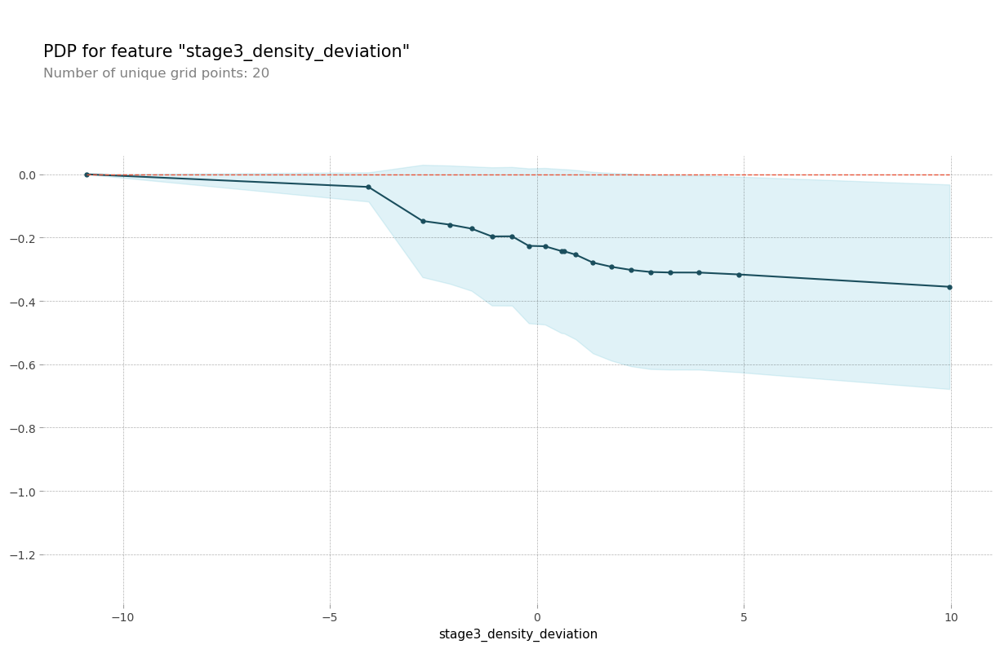

In [ ]:
target_feature = "stage3_density_deviation"

isolated = pdp_isolate(
    model=xgb_pipe2[-1],
    dataset=X_val_impute_df,
    model_features=X_val_impute_df.columns,
    feature=target_feature,
    grid_type="percentile",  # default = 'percentile', or 'equal'
    num_grid_points=20,  # default = 10
)
pdp_plot(isolated, feature_name=target_feature)

반대로 stage3의 약품 투여 밀도는 높을수록 불량률이 낮아진다

(<Figure size 1500x950 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb7ac7c0>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb7bf9d0>})

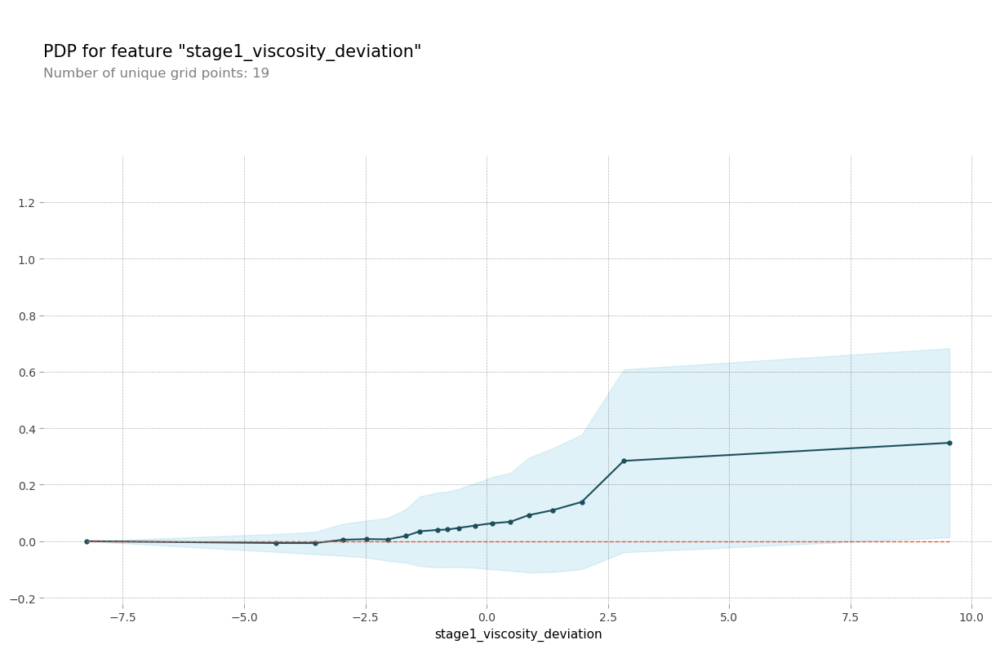

In [ ]:
target_feature = "stage1_viscosity_deviation"

isolated = pdp_isolate(
    model=xgb_pipe2[-1],
    dataset=X_val_impute_df,
    model_features=X_val_impute_df.columns,
    feature=target_feature,
    grid_type="percentile",  # default = 'percentile', or 'equal'
    num_grid_points=20,  # default = 10
)
pdp_plot(isolated, feature_name=target_feature)

stage1의 약품 점성은 높아질수록 불량률이 높아진다.

(<Figure size 1500x950 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb817850>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb9aa550>})

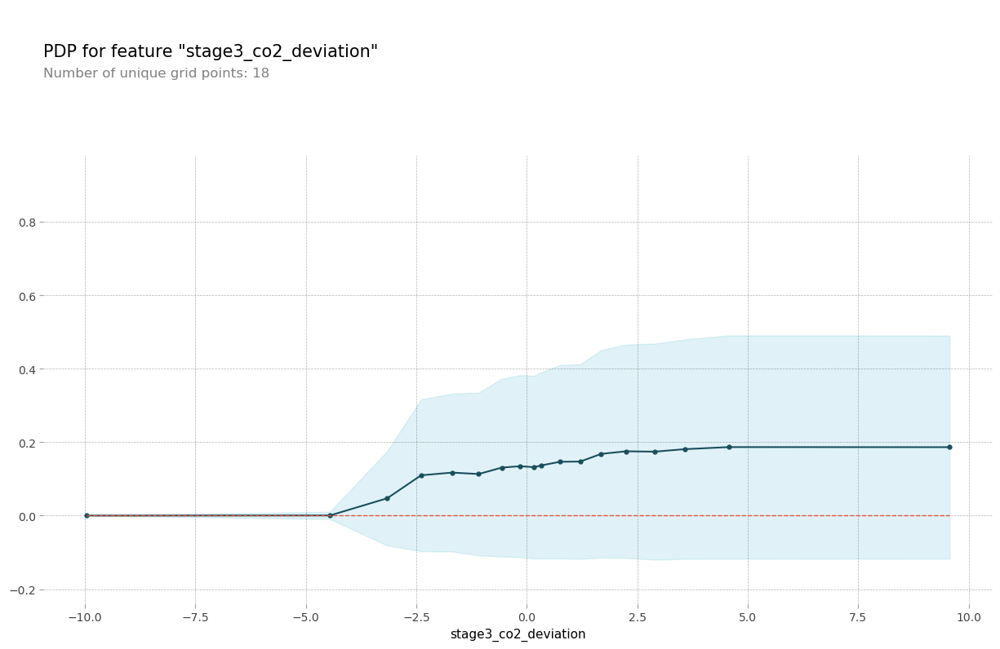

In [ ]:
target_feature = "stage3_co2_deviation"

isolated = pdp_isolate(
    model=xgb_pipe2[-1],
    dataset=X_val_impute_df,
    model_features=X_val_impute_df.columns,
    feature=target_feature,
    grid_type="percentile",  # default = 'percentile', or 'equal'
    num_grid_points=20,  # default = 10
)
pdp_plot(isolated, feature_name=target_feature)


stage3의 CO2 발생량이 높은 구간에서 불량률이 높아지는 경향을 보인다,

(<Figure size 1500x950 with 2 Axes>,
 {'title_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb653700>,
  'pdp_ax': <matplotlib.axes._subplots.AxesSubplot at 0x7f86eb67dcd0>})

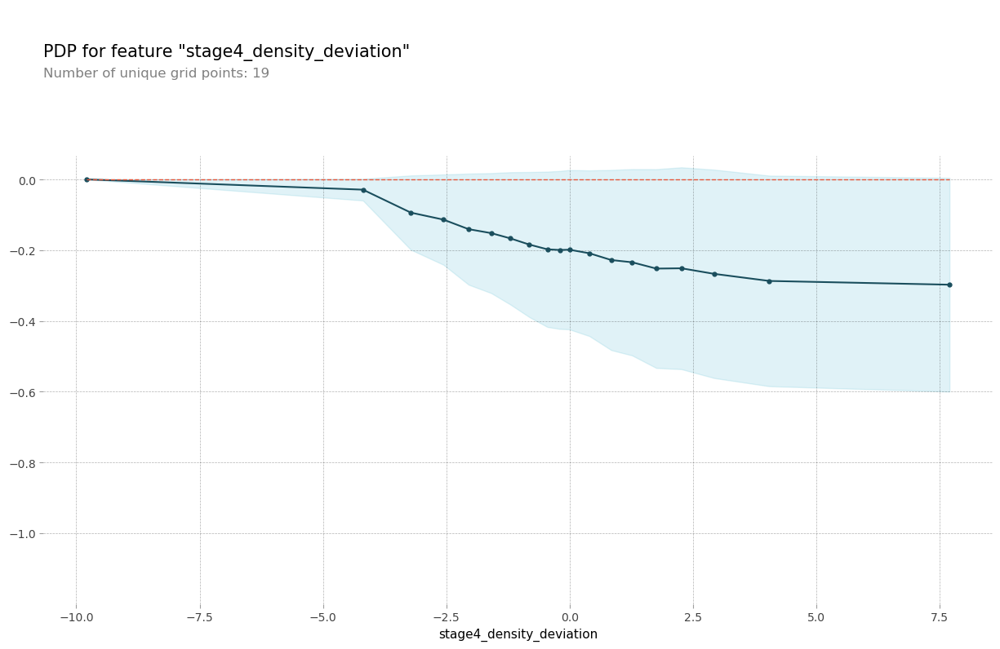

In [ ]:
target_feature = "stage4_density_deviation"

isolated = pdp_isolate(
    model=xgb_pipe2[-1],
    dataset=X_val_impute_df,
    model_features=X_val_impute_df.columns,
    feature=target_feature,
    grid_type="percentile",  # default = 'percentile', or 'equal'
    num_grid_points=20,  # default = 10
)
pdp_plot(isolated, feature_name=target_feature)


stage4의 약품 밀도는 높아질수록 불량률이 낮아진다.

요약하자면 PDP에서 보여주듯이 기준치에서 절대값이 큰 값일수록 불량품이 많이 발생할거란 예상과 달리 단방향으로만 불량율이 늘어나거나 감소하는 추세를 볼 수 있었다. 즉 최저과 최고선을 둘 다 제어할 필요없이 한쪽으로의 이상치만 제어함으로써 불량률을 효과적으로 통제할 수 있을거라고 기대할 수 있다.

In [ ]:
import shap

In [ ]:
explainer = shap.TreeExplainer(xgb_pipe2[-1])
shap_values = explainer(X_val_impute_df)

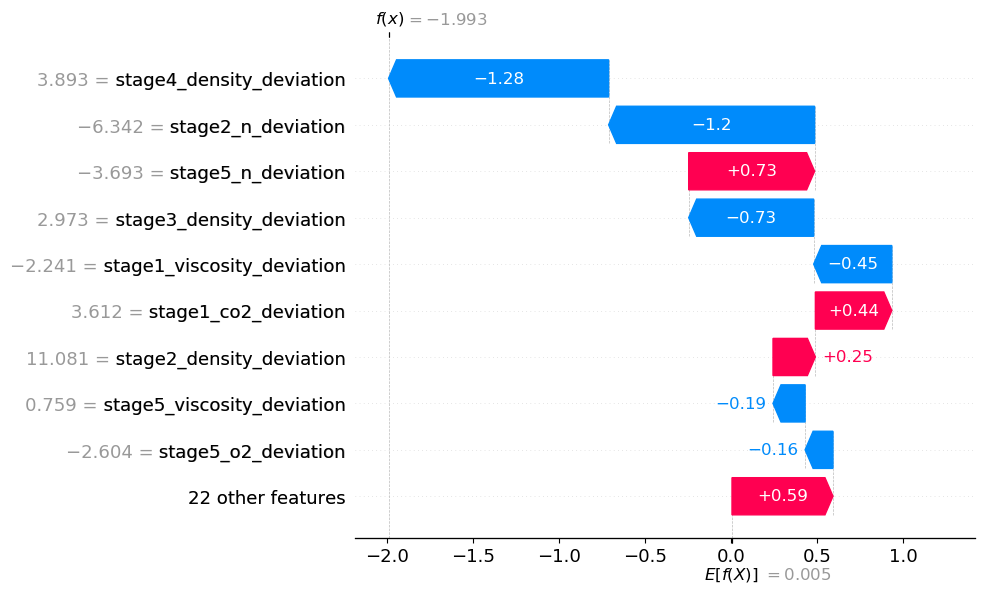

In [ ]:
shap.plots.waterfall(shap_values[0,:])

In [ ]:
shap.initjs()
shap.plots.force(shap_values[0,:])

shap 도구를 통해 어떤 변수가 불량률에 어떤 방향으로 영향을 주는지 파악할 수 있다.

##**3-3. 결론 및 한계점** 



- 결론
 - Baseline model에서 79.8% 였던 정확도가 90%로 상승하였다.
 - f1 score는 0에서 0.78로 상승하였다.
 - 특히 Recall을 제일 중시하여 모델을 선정한 결과 90% 의 불량품을 올바로 판정하는 모델을 구축할 수 있었다. (Recall = 0.9)
 - 모델 성능에 높은 영향을 주는 변수들을 더 자세히 조사하여 더 좋은 모델을 구축할 수 있다.
 - 불량율에 특히 영향을 주는 요소들로는 stage4_density_deviation, stage5_n_deviation 등이 있고(shap 참조) 이를 중점적으로 제어함으로써 같은 제어 비용으로 더 높은 수율을 얻을 수 있을거라 기대할 수 있다.
 - 특히 처음 예상했던 기준점에서 단순히 편차가 클수록 불량이 높아질거라 생각했던 것과 달리 특정 변수들은 오로지 단방향 제어로 수율 상승을 기대할 수 있었다. 이는 양방향 제어에 비해 제어가 더 쉬울것으로 추측되며 수율을 위한 변수 제어비용을 낮출 수 있을것으로 기대된다.

- 한계점  
  - 양품을 불량으로 판정했을때의 기회손실비용과 불량을 양품으로 판정했을때 기업이 받을 잠재적 손해를 수치상으로 비교할 수 없어 (도메인적 데이터 부족) 비지니스적 액션으로 이어지는건 어려움이 있다.
  - 시간상의 한계로 인해 더 많은 하이퍼 파라미터 튜닝 및 일반화 성능 향상을 하지 못한 부분이 아쉬움으로 남는다.
